# **2D NeRF**

In [47]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time
import gdown
import torchvision.transforms as transforms
import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cpu


In [10]:
url = "https://drive.google.com/file/d/1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT/view?usp=share_link"
gdown.download(url=url, output='starry_night.jpg', quiet=False, fuzzy=True)

# Load painting image
painting = imageio.imread("starry_night.jpg")
painting = torch.from_numpy(np.array(painting, dtype=np.float32)/255.).to(device)
height_painting, width_painting = painting.shape[:2]

Downloading...
From: https://drive.google.com/uc?id=1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT
To: /content/starry_night.jpg
100%|██████████| 5.65k/5.65k [00:00<00:00, 8.08MB/s]


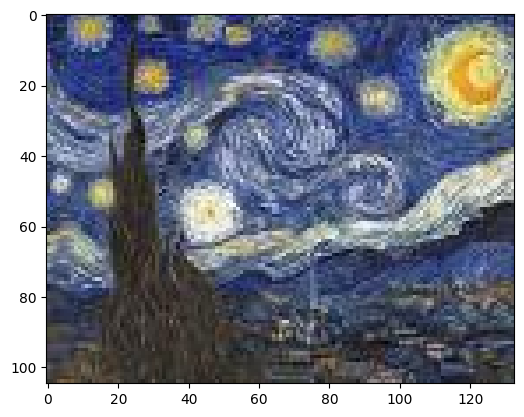

In [11]:
plt.imshow(painting)
plt.show()

In [12]:
def positional_encoding(x, num_frequencies=6, incl_input=True):
    """
    Apply positional encoding to the input.

    Args:
    x (torch.Tensor): Input tensor to be positionally encoded.
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor.
    """

    N = x.shape[0]
    D = x.shape[1]

    ones_tensor = torch.ones((num_frequencies, N, D))
    two_powers_tensor = torch.pow(2, torch.arange(num_frequencies)).view(-1, 1, 1)

    concatenated_tensor = ones_tensor * two_powers_tensor
    concatenated_tensor = concatenated_tensor * x

    concatenated_tensor = concatenated_tensor.permute(1,0,2)

    concatenated_tensor = torch.pi * concatenated_tensor

    sine_theta = torch.sin(concatenated_tensor)
    cos_theta = torch.cos(concatenated_tensor)

    combined = torch.cat((sine_theta, cos_theta), dim=2)

    combined = combined.reshape(N, -1)

    if incl_input:
      combined = torch.hstack((x, combined))

    return combined

In [18]:
torch.manual_seed(0)

ip = torch.rand(25,2)

import time

a_start = time.time()
a = positional_encoding(ip, 3, True)
a_end = time.time()

print("Time taken for positional_encoding1 : ", a_end-a_start)

Time taken for positional_encoding1 :  0.0007355213165283203


In [24]:
class model_2d(nn.Module):

    """
    Define a 2D model comprising of three fully connected layers,
    two relu activations and one sigmoid activation.
    """

    def __init__(self, filter_size=128, num_frequencies=6):
      super().__init__()

      self.linear_1 = nn.Linear(4*num_frequencies + 2, filter_size) # Shape 2*N*num_frequencies + 2.....inclusive input
      self.linear_2 = nn.Linear(filter_size, filter_size)
      self.linear_3 = nn.Linear(filter_size, 3)
      self.relu = nn.ReLU()
      self.sigmoid = nn.Sigmoid()

    def forward(self, x):
      x = self.linear_1(x)
      x = self.relu(x)

      x = self.linear_2(x)
      x = self.relu(x)

      x = self.linear_3(x)
      x = self.sigmoid(x)

      return x

In [20]:
import torch
import numpy as np

height = 256
width = 256

pos_enc_ip = torch.rand(height,width)
xx, yy = np.meshgrid(np.linspace(0, 1, width), np.linspace(0, 1, height))
coordinates = np.concatenate([xx.reshape(-1, 1), yy.reshape(-1, 1)], axis=1)
print(coordinates.shape)

xx, yy = torch.meshgrid(torch.linspace(0,1,width), torch.linspace(0,1,height))
coordinates = torch.cat((xx.reshape(-1,1), yy.reshape(-1,1)), dim=1)
print(coordinates.shape)

(65536, 2)
torch.Size([65536, 2])


In [48]:
def train_2d_model(test_img, num_frequencies, device, model=model_2d, positional_encoding=positional_encoding, show=True):
  learning_rate = 5e-4
  iterations = 10000

  H, W, _ = test_img.shape

  model_2d = model(num_frequencies=num_frequencies)
  model_2d = model_2d.to(device)

  def init_weights(m):
    if isinstance(m, nn.Linear):
      torch.nn.init.xavier_uniform_(m.weight)

  model_2d.apply(init_weights)

  optimizer = torch.optim.Adam(model_2d.parameters(), lr=learning_rate)
  loss_fn = nn.MSELoss()

  seed = 5670
  torch.manual_seed(seed)
  np.random.seed(seed)

  psnrs = []
  losses = []
  iternums = []
  display = 2000

  t0 = time.time()
  t = time.time()



  xx, yy = torch.meshgrid(torch.linspace(0,1,H), torch.linspace(0,1,W))
  coordinates = torch.cat((xx.reshape(-1,1), yy.reshape(-1,1)), dim=1)
  ip_pos_enc = positional_encoding(coordinates, num_frequencies=num_frequencies, incl_input=True)

  for i in tqdm.tqdm(range(iterations)):
    ip_pos_enc = ip_pos_enc.to(device)

    optimizer.zero_grad()

    pred = model_2d(ip_pos_enc)
    pred = pred.reshape(H, W, 3)

    loss = loss_fn(pred, test_img)

    loss.backward()
    optimizer.step()

    if i % display == 0 and show:
        psnr = 10*torch.log10(1/loss)

        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f" % psnr.item(), \
            "Time: %.2f secs per iter" % ((time.time() - t) / display), "%.2f secs in total" % (time.time() - t0))
        t = time.time()

        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(13, 4))
        plt.subplot(131)
        plt.imshow(pred.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(132)
        plt.imshow(test_img.cpu().numpy())
        plt.title("Target image")
        plt.subplot(133)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

  print('Done!')
  return pred.detach().cpu()


  0%|          | 0/10000 [00:00<?, ?it/s]

Iteration 0  Loss: 0.0523  PSNR: 12.82 Time: 0.00 secs per iter 0.09 secs in total


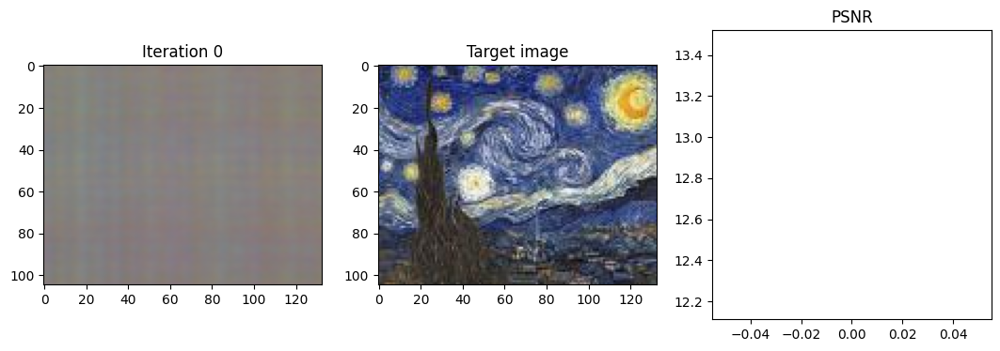

 20%|█▉        | 1999/10000 [01:56<07:08, 18.69it/s]

Iteration 2000  Loss: 0.0033  PSNR: 24.76 Time: 0.06 secs per iter 116.32 secs in total


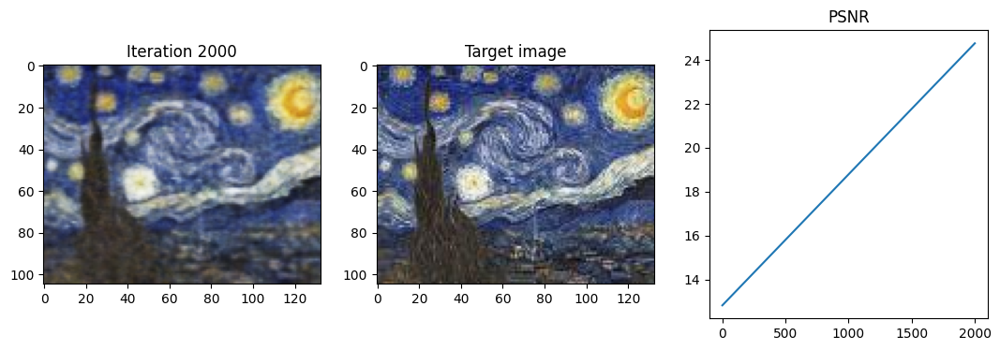

 40%|████      | 4000/10000 [03:54<05:38, 17.72it/s]

Iteration 4000  Loss: 0.0025  PSNR: 26.07 Time: 0.06 secs per iter 234.14 secs in total


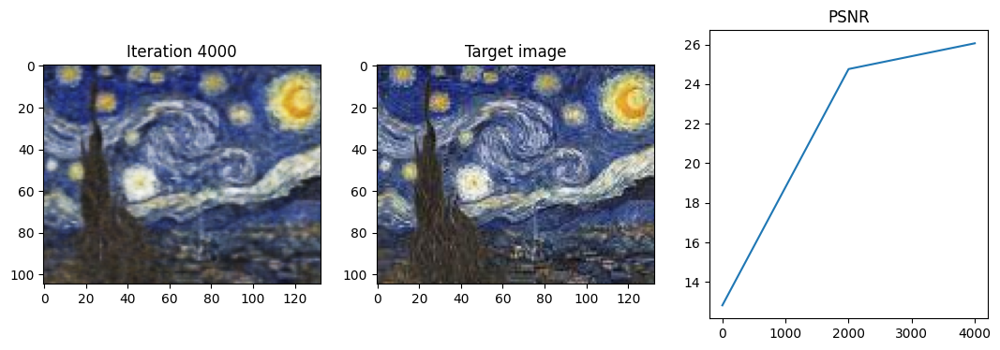

 60%|█████▉    | 5999/10000 [05:56<03:44, 17.81it/s]

Iteration 6000  Loss: 0.0021  PSNR: 26.85 Time: 0.06 secs per iter 356.63 secs in total


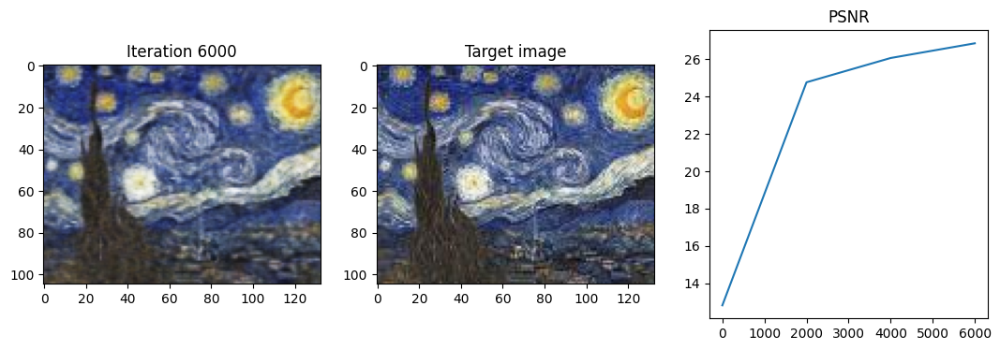

 80%|████████  | 8000/10000 [07:51<01:48, 18.37it/s]

Iteration 8000  Loss: 0.0018  PSNR: 27.38 Time: 0.06 secs per iter 471.11 secs in total


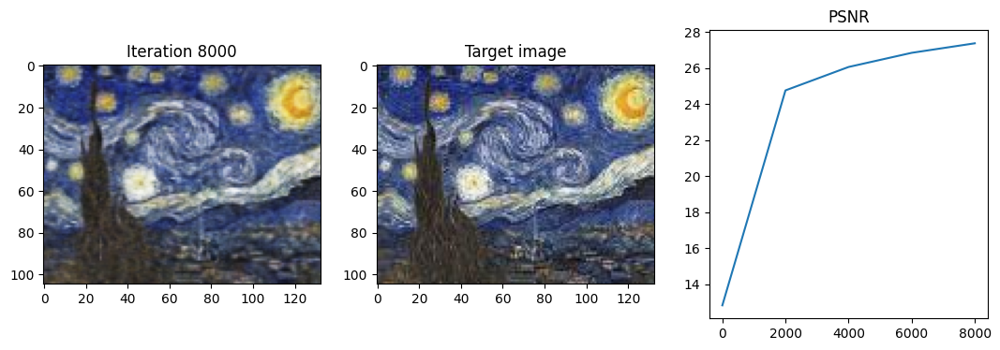

100%|██████████| 10000/10000 [09:57<00:00, 16.75it/s]

Done!


In [49]:
_ = train_2d_model(test_img=painting, num_frequencies=6, device=device)

#**3D NeRF**

In [1]:
import os
import gdown
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F
import time
from tqdm import tqdm
from scipy.spatial.transform import Rotation as R

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [2]:
url = "https://drive.google.com/file/d/15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj/view?usp=share_link"
gdown.download(url=url, output='lego_data.npz', quiet=False, fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj
To: /content/lego_data.npz
100%|██████████| 12.7M/12.7M [00:00<00:00, 26.5MB/s]


'lego_data.npz'

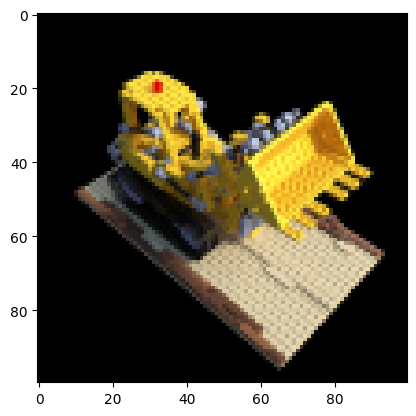

In [3]:
# Load input images, poses, and intrinsics
data = np.load("lego_data.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
poses = data["poses"]
poses = torch.from_numpy(poses).to(device)

# Camera intrinsics
intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)

# Hold one image out (for test).
test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

In [4]:
print("Poses : ", poses.shape)
print("Images : ", images.shape)
print("Intrinsics : ", intrinsics)

Poses :  torch.Size([106, 4, 4])
Images :  torch.Size([100, 100, 100, 3])
Intrinsics :  tensor([[138.8889,   0.0000,  50.0000],
        [  0.0000, 138.8889,  50.0000],
        [  0.0000,   0.0000,   1.0000]], device='cuda:0')


In [5]:
def get_rays(height, width, intrinsics, Rcw, Tcw):

    """
    Compute the origin and direction of rays passing through all pixels of an image (one ray per pixel).

    Args:
    height: the height of an image.
    width: the width of an image.
    intrinsics: camera intrinsics matrix of shape (3, 3).
    Rcw: Rotation matrix of shape (3,3) from camera to world coordinates.
    Tcw: Translation vector of shape (3,1) that transforms

    Returns:
    ray_origins (torch.Tensor): A tensor of shape (height, width, 3) denoting the centers of
      each ray. Note that desipte that all ray share the same origin, here we ask you to return
      the ray origin for each ray as (height, width, 3).
    ray_directions (torch.Tensor): A tensor of shape (height, width, 3) denoting the
      direction of each ray.
    """

    device = intrinsics.device
    ray_directions = torch.ones((height, width, 3), device=device)  # placeholder
    ray_origins = torch.ones((height, width, 3), device=device)  # placeholder

    origin = Tcw
    origin = origin.view(-1,1,3)
    ray_origins = origin * ray_origins

    vv, uu = torch.meshgrid(torch.arange(height), torch.arange(width), indexing='ij')
    uu = uu.to(device)
    vv = vv.to(device)

    P_inv = torch.linalg.inv(intrinsics)

    ray_directions[:, :, 0] = uu
    ray_directions[:, :, 1] = vv


    ray_directions = ray_directions.view(-1,3)

    ray_directions = (torch.linalg.inv(intrinsics) @ ray_directions.T).T @ Rcw
    ray_directions = ray_directions.view(height, width, 3)

    return ray_origins, ray_directions


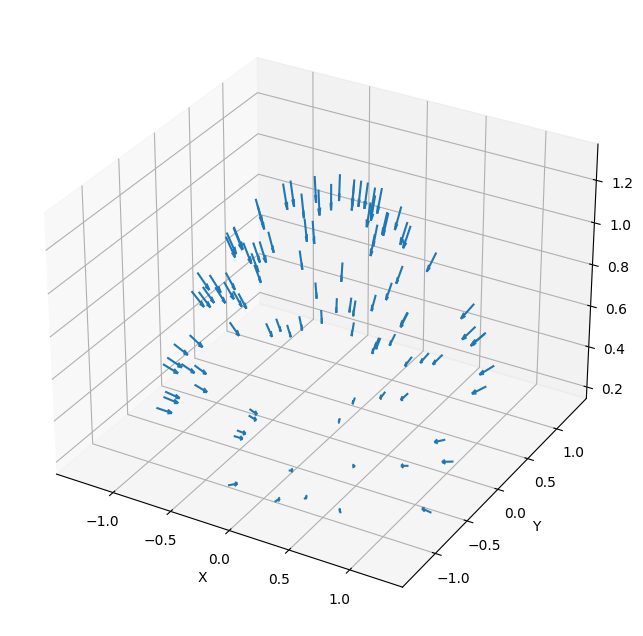

In [6]:
def plot_all_poses(poses):

    origins = []
    directions = []
    K = torch.tensor(data['intrinsics'])
    cx = K[0,2].int()
    cy = K[1,2].int()

    for i in range(poses.shape[0]):
      Rcw = torch.tensor(poses[i][:3,:3]).T
      Tcw = torch.tensor(poses[i][:3,-1])
      one_orig, one_dir = get_rays(height, width, K, Rcw, Tcw)
      origins.append(one_orig[cx, cy])
      directions.append(one_dir[cx, cy])

    origins = torch.stack(origins)
    directions = torch.stack(directions)

    ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('z')
    plt.show()

plot_all_poses(data['poses'])

In [7]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):
    """
    Sample 3D points on the given rays. The near and far variables indicate the bounds of sampling range.

    Args:
    ray_origins: Origin of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    ray_directions: Direction of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    near: The 'near' extent of the bounding volume.
    far:  The 'far' extent of the bounding volume.
    samples: Number of samples to be drawn along each ray.

    Returns:
    ray_points: Query 3D points along each ray. Shape: (height, width, samples, 3).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
    """
    H, W, _ = ray_origins.shape
    ray_origins = ray_origins.to(device)
    ray_directions = ray_directions.to(device)

    ray_sample = torch.linspace(near, far, samples+1)[:-1].to(device)

    depth_points = torch.ones(H, W).view(H,W,1).to(device) * ray_sample.view(1,1,samples)

    ray_points = ray_directions.unsqueeze(-2) * ray_sample.view(1, 1, samples, 1) + ray_origins.unsqueeze(-2)

    return ray_points, depth_points


In [8]:
class nerf_model(nn.Module):

    """
    Define a NeRF model comprising eight fully connected layers and following the
    architecture described in the NeRF paper.
    """

    def __init__(self, filter_size=256, num_x_frequencies=6, num_d_frequencies=3):
        super().__init__()

        self.linear1 = nn.Linear(2*num_x_frequencies*3+3, filter_size) #input = 2*L*D+D
        self.linear2 = nn.Linear(filter_size, filter_size)
        self.linear3 = nn.Linear(filter_size, filter_size)
        self.linear4 = nn.Linear(filter_size, filter_size)
        self.linear5 = nn.Linear(filter_size, filter_size)

        self.linear6 = nn.Linear(filter_size+2*num_x_frequencies*3+3, filter_size) # add positional encoding X
        self.linear7 = nn.Linear(filter_size, filter_size)
        self.linear8 = nn.Linear(filter_size, filter_size)

        self.linearsigma = nn.Linear(filter_size, 1)

        self.linear9 = nn.Linear(filter_size, filter_size) # add positional encoding D
        self.linear10 = nn.Linear(filter_size + 2*num_d_frequencies*3 + 3, 128)
        self.linear11 = nn.Linear(128, 3) # output = 3 (R,G,B)

        self.relu1    = nn.ReLU()
        self.relu2    = nn.ReLU()
        self.relu3    = nn.ReLU()
        self.relu4    = nn.ReLU()
        self.relu5    = nn.ReLU()
        self.relu6    = nn.ReLU()
        self.relu7    = nn.ReLU()
        self.relu8    = nn.ReLU()
        self.relu9    = nn.ReLU()
        self.sigmoid = nn.Sigmoid()


    def forward(self, x, d):
        x1 = self.relu1(self.linear1(x))
        x1 = self.relu2(self.linear2(x1))
        x1 = self.relu3(self.linear3(x1))
        x1 = self.relu4(self.linear4(x1))
        x1 = self.relu5(self.linear5(x1))
        x2 = torch.cat([x1, x], dim=-1)
        x2 = self.relu6(self.linear6(x2))
        x2 = self.relu7(self.linear7(x2))
        x2 = self.relu8(self.linear8(x2))
        sigma = self.linearsigma(x2)
        x2 = self.linear9(x2)
        x3 = torch.cat([x2,d], dim=-1)
        x3 = self.relu9(self.linear10(x3))
        x3 = self.linear11(x3)
        rgb = self.sigmoid(x3)

        return rgb, sigma

In [9]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):
  def get_chunks(inputs, chunksize = 2**15):
    return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

  def positional_encoding(x, num_frequencies=6, incl_input=True):
    """
    Apply positional encoding to the input.

    Args:
    x (torch.Tensor): Input tensor to be positionally encoded.
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor.
    """

    N = x.shape[0]
    D = x.shape[1]

    ones_tensor = torch.ones((num_frequencies, N, D)).to(device)
    two_powers_tensor = torch.pow(2, torch.arange(num_frequencies)).view(-1, 1, 1).to(device)

    concatenated_tensor = ones_tensor * two_powers_tensor
    concatenated_tensor = concatenated_tensor * x

    concatenated_tensor = concatenated_tensor.permute(1,0,2)

    concatenated_tensor = torch.pi * concatenated_tensor

    sine_theta = torch.sin(concatenated_tensor)
    cos_theta = torch.cos(concatenated_tensor)

    combined = torch.cat((sine_theta, cos_theta), dim=2)

    combined = combined.reshape(N, -1)

    if incl_input:
      combined = torch.hstack((x, combined))

    return combined

  """
  This function returns chunks of the ray points and directions to avoid memory errors with the
  neural network. It also applies positional encoding to the input points and directions before
  dividing them into chunks, as well as normalizing and populating the directions.
  """
  ray_directions_normalized = ray_directions/(torch.linalg.norm(ray_directions, axis=2, keepdim=True) + 1e-10) # (H,W,N,3)
  all_ray_dirs = ray_directions_normalized.unsqueeze(-2) * torch.ones_like(ray_points)    # (H,W,N,3)
  pos_enc_pt_output   = positional_encoding(ray_points.view(-1, 3), num_x_frequencies, True)
  pos_enc__dir_output = positional_encoding(all_ray_dirs.view(-1, 3), num_d_frequencies, True)
  ray_points_batches = get_chunks(pos_enc_pt_output)
  ray_directions_batches = get_chunks(pos_enc__dir_output)

  return ray_points_batches, ray_directions_batches

In [10]:
def volumetric_rendering(rgb, sigma, depth_points):
    """
    Differentiably renders a radiance field, given the origin of each ray in the
    "bundle", and the sampled depth values along them.

    Args:
    rgb: RGB color at each query location (X, Y, Z). Shape: (height, width, samples, 3).
    sigma: Volume density at each query location (X, Y, Z). Shape: (height, width, samples).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).

    Returns:
    rec_image: The reconstructed image after applying the volumetric rendering to every pixel.
    Shape: (height, width, 3)
    """

    H, W, N = depth_points.shape
    del_i = depth_points[:,:,1:] - depth_points[:,:,:-1]   #(H,W,samples-1)
    # rgb = torch.nn.Sigmoid()(rgb)

    sigma = torch.nn.ReLU()(sigma)

    T_i = torch.cumprod(torch.exp(-del_i * sigma[:,:, :-1]), axis=2)
    T_i = torch.cat([torch.ones(H,W,1).to(device), T_i], dim=-1)

    del_i = torch.cat([del_i, 1e9*torch.ones(H,W,1).to(device)], dim=-1)   #(H,W,samples)
    rec_image = torch.sum(T_i.unsqueeze(-1) * (1 - torch.exp(-del_i * sigma)).unsqueeze(-1) * rgb, axis=2)

    alpha = 1 - torch.exp(-sigma * del_i)

    alpha = torch.cat([torch.ones(H,W,1).to(device), alpha], dim=-1)

    weights = alpha * torch.cumprod(1. - alpha + 1e-10, dim=-1)
    weights = weights[:,:,:-1]

    depth_map = torch.sum(weights * depth_points, -1)

    return rec_image, depth_map

In [12]:
def one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies):

    #compute all the rays from the image
    Rcw = pose[:3,:3].T
    Tcw = pose[:3,-1]
    ray_origins, ray_directions = get_rays(height, width, intrinsics, Rcw, Tcw)

    #sample the points from the rays
    ray_points, depth_points = stratified_sampling(ray_origins, ray_directions, near, far, samples)

    #divide data into batches to avoid memory errors
    ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies)

    #forward pass the batches and concatenate the outputs at the end
    final_rgb = []
    final_sig = []
    for i in range(len(ray_points_batches)):
      rgb, sigma = model(ray_points_batches[i], ray_directions_batches[i])

      final_rgb.append(rgb)
      final_sig.append(sigma)

    rgb_stacked = torch.cat(final_rgb, dim=0).reshape(height, width, samples, 3)
    sigma_stacked = torch.vstack(final_sig).reshape(height, width,samples)

    # Apply volumetric rendering to obtain the reconstructed image
    rec_image, depth_img = volumetric_rendering(rgb_stacked, sigma_stacked, depth_points)

    return rec_image, depth_img

In [12]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
criterion = nn.MSELoss()

psnrs = []
iternums = []

t = time.time()
t0 = time.time()

  0%|          | 0/3001 [00:00<?, ?it/s]

Iteration 0  Loss: 0.1518  PSNR: 8.19  Time: 0.32 secs per iter,  0.13 mins in total


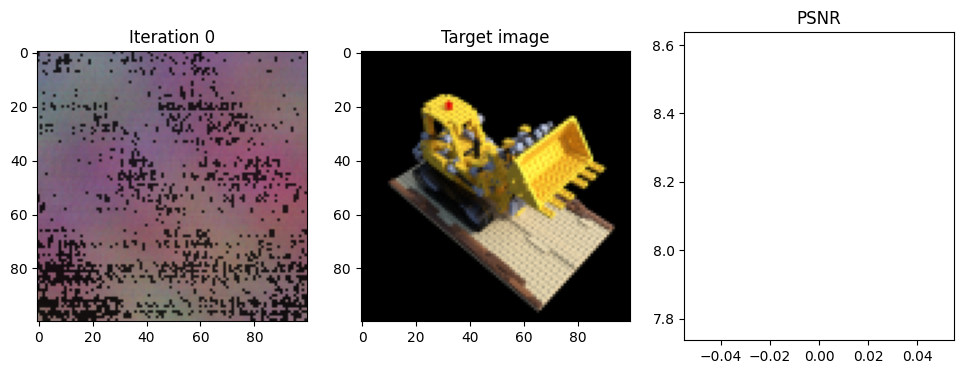

  1%|          | 25/3001 [00:23<45:18,  1.09it/s]

Iteration 25  Loss: 0.0856  PSNR: 10.67  Time: 0.94 secs per iter,  0.52 mins in total


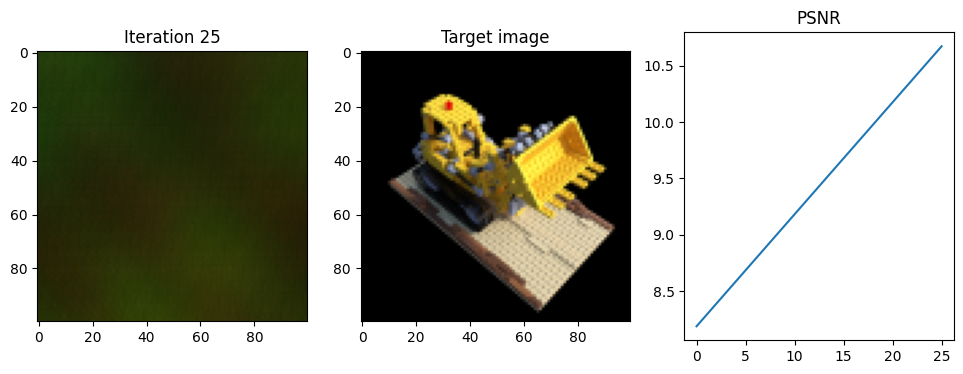

  2%|▏         | 50/3001 [00:46<44:24,  1.11it/s]

Iteration 50  Loss: 0.0854  PSNR: 10.68  Time: 0.94 secs per iter,  0.91 mins in total


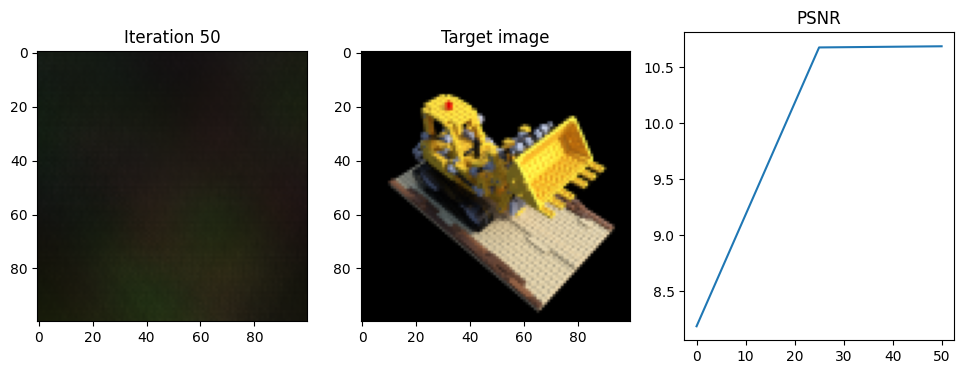

  2%|▏         | 75/3001 [01:09<43:07,  1.13it/s]

Iteration 75  Loss: 0.0732  PSNR: 11.36  Time: 0.92 secs per iter,  1.30 mins in total


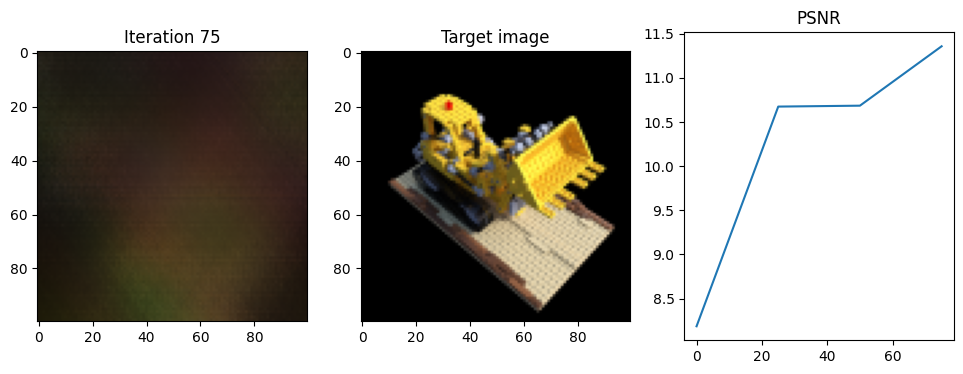

  3%|▎         | 100/3001 [01:32<42:23,  1.14it/s]

Iteration 100  Loss: 0.0537  PSNR: 12.70  Time: 0.91 secs per iter,  1.68 mins in total


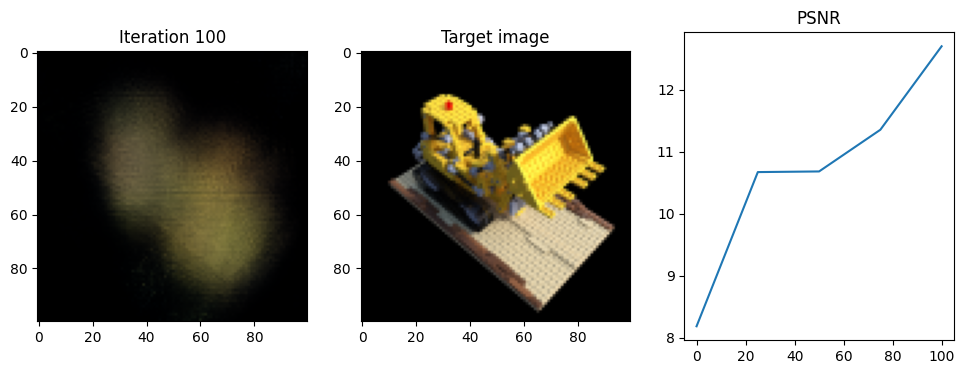

  4%|▍         | 125/3001 [01:55<41:12,  1.16it/s]

Iteration 125  Loss: 0.0354  PSNR: 14.50  Time: 0.91 secs per iter,  2.05 mins in total


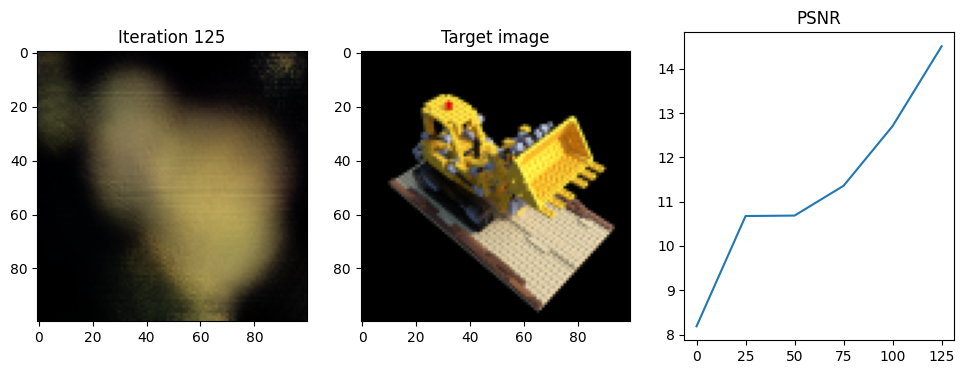

  5%|▍         | 150/3001 [02:17<40:54,  1.16it/s]

Iteration 150  Loss: 0.0449  PSNR: 13.47  Time: 0.91 secs per iter,  2.43 mins in total


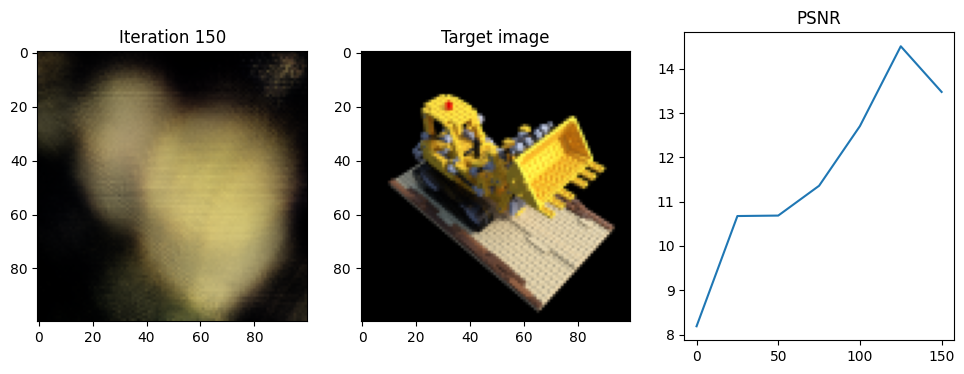

  6%|▌         | 175/3001 [02:40<40:05,  1.17it/s]

Iteration 175  Loss: 0.0295  PSNR: 15.31  Time: 0.90 secs per iter,  2.81 mins in total


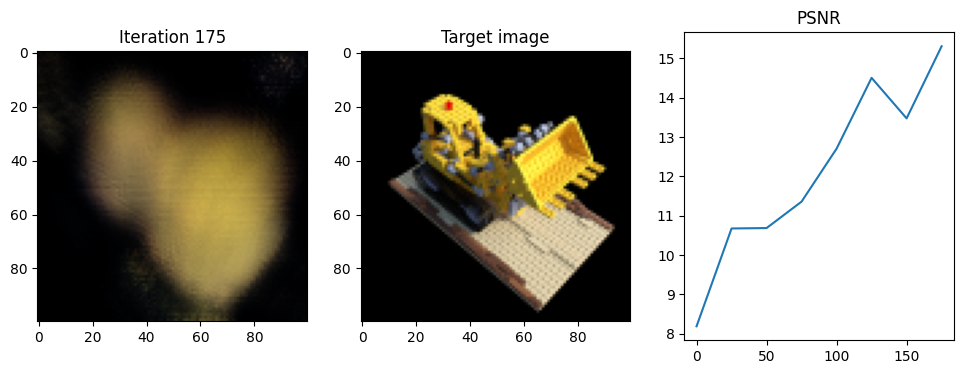

  7%|▋         | 200/3001 [03:03<40:14,  1.16it/s]

Iteration 200  Loss: 0.0274  PSNR: 15.62  Time: 0.91 secs per iter,  3.19 mins in total


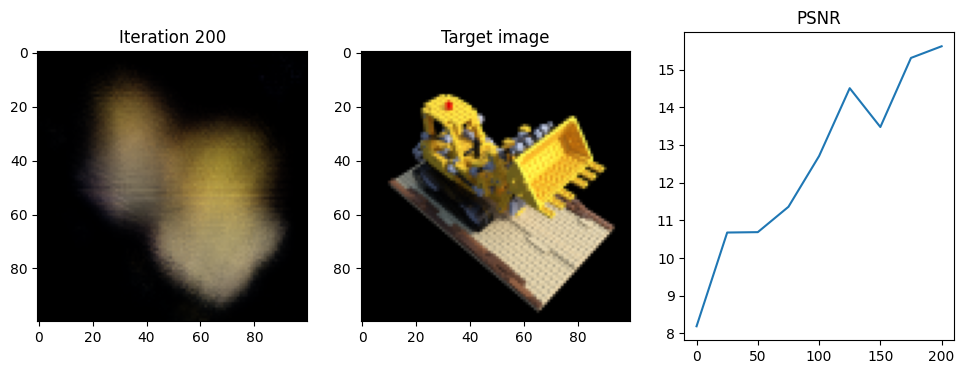

  7%|▋         | 225/3001 [03:25<39:57,  1.16it/s]

Iteration 225  Loss: 0.0208  PSNR: 16.82  Time: 0.90 secs per iter,  3.56 mins in total


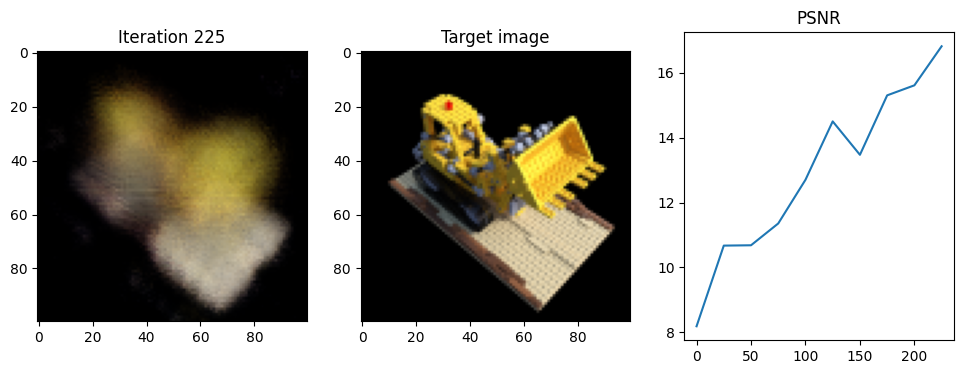

  8%|▊         | 250/3001 [03:47<39:27,  1.16it/s]

Iteration 250  Loss: 0.0174  PSNR: 17.60  Time: 0.89 secs per iter,  3.93 mins in total


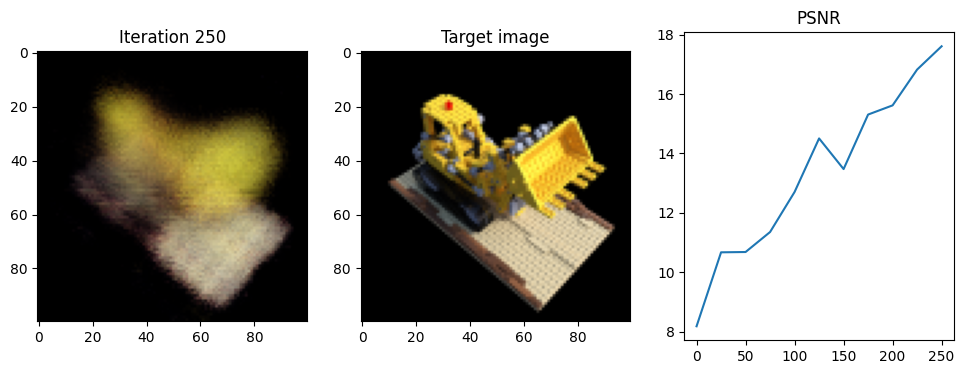

  9%|▉         | 275/3001 [04:10<39:12,  1.16it/s]

Iteration 275  Loss: 0.0178  PSNR: 17.50  Time: 0.89 secs per iter,  4.31 mins in total


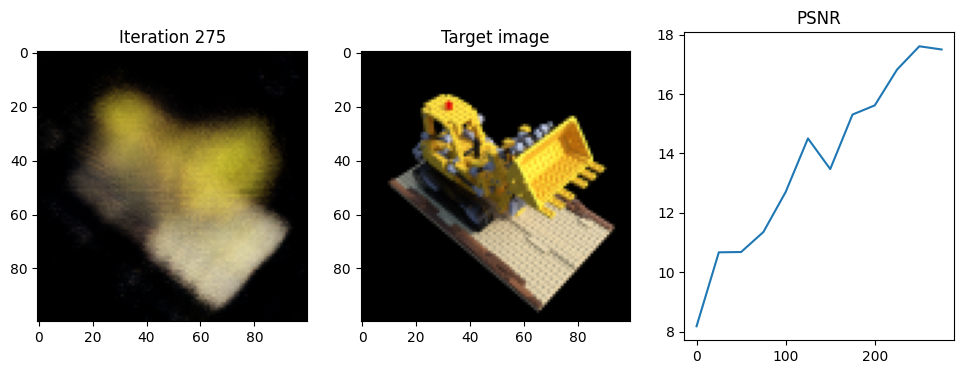

 10%|▉         | 300/3001 [04:32<38:19,  1.17it/s]

Iteration 300  Loss: 0.0145  PSNR: 18.39  Time: 0.90 secs per iter,  4.68 mins in total


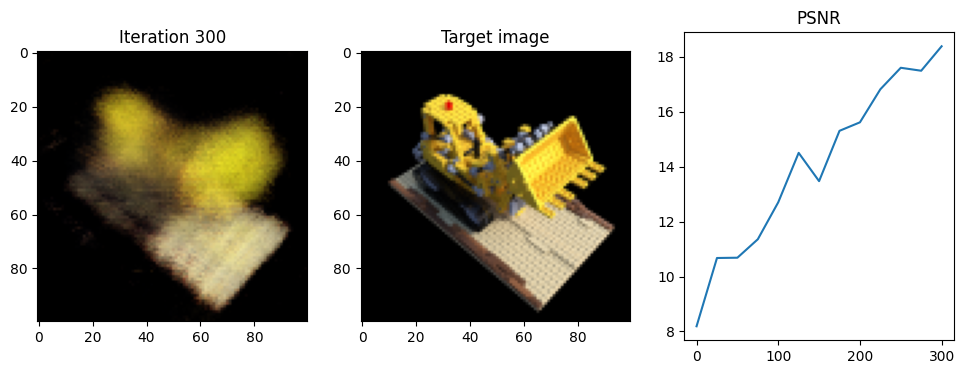

 11%|█         | 325/3001 [04:54<37:55,  1.18it/s]

Iteration 325  Loss: 0.0134  PSNR: 18.71  Time: 0.89 secs per iter,  5.05 mins in total


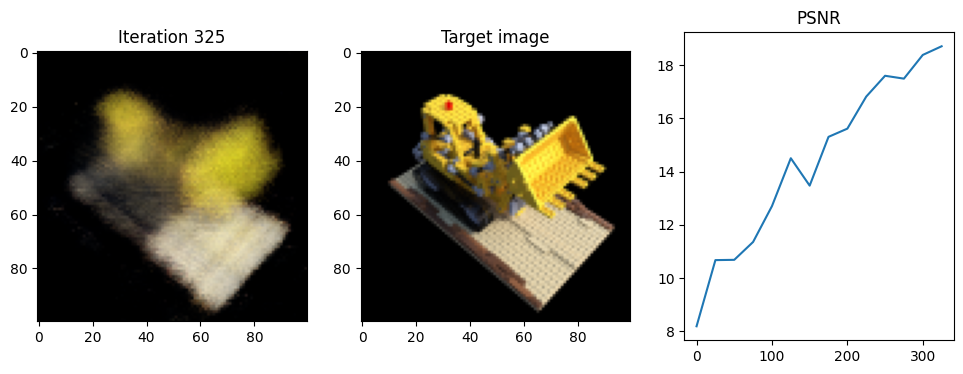

 12%|█▏        | 350/3001 [05:16<37:26,  1.18it/s]

Iteration 350  Loss: 0.0133  PSNR: 18.77  Time: 0.88 secs per iter,  5.42 mins in total


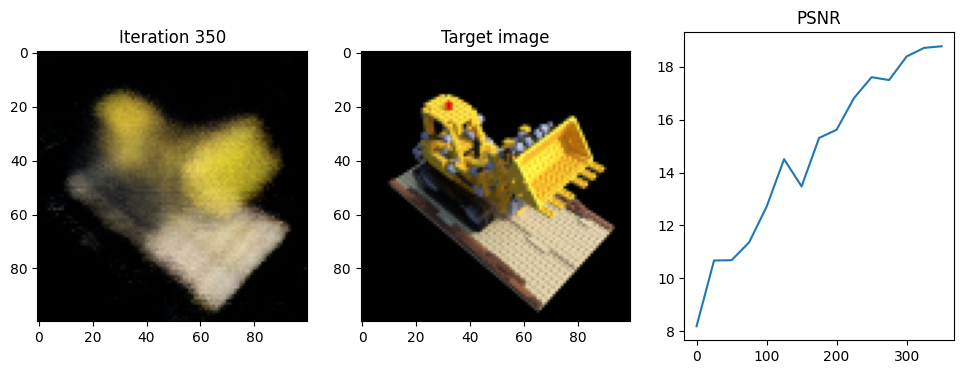

 12%|█▏        | 375/3001 [05:39<37:21,  1.17it/s]

Iteration 375  Loss: 0.0123  PSNR: 19.12  Time: 0.88 secs per iter,  5.79 mins in total


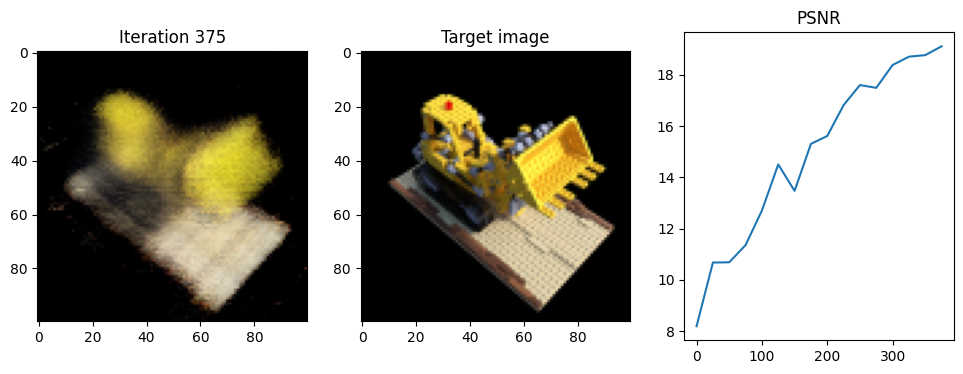

 13%|█▎        | 400/3001 [06:00<36:26,  1.19it/s]

Iteration 400  Loss: 0.0118  PSNR: 19.30  Time: 0.88 secs per iter,  6.15 mins in total


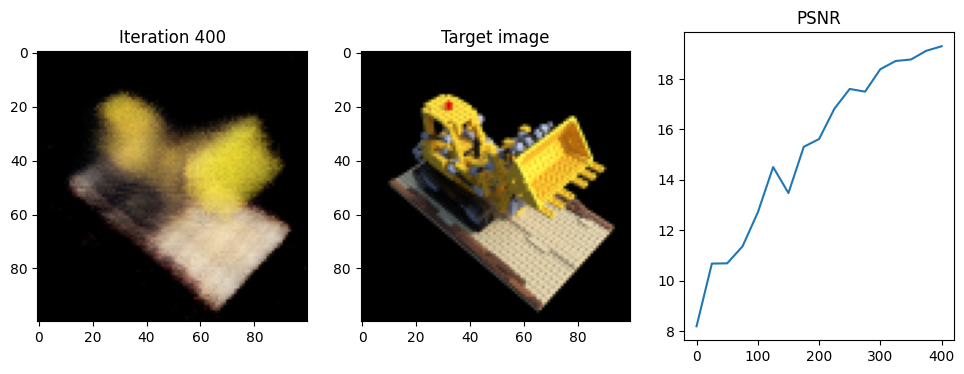

 14%|█▍        | 425/3001 [06:23<36:21,  1.18it/s]

Iteration 425  Loss: 0.0118  PSNR: 19.30  Time: 0.90 secs per iter,  6.53 mins in total


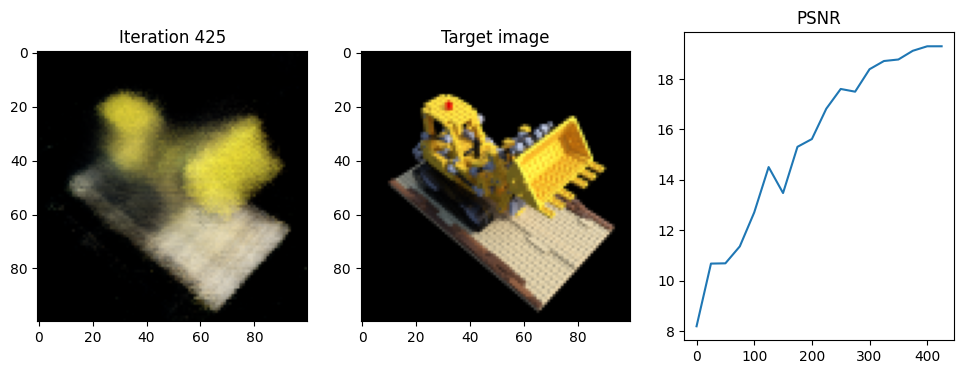

 15%|█▍        | 450/3001 [06:45<36:00,  1.18it/s]

Iteration 450  Loss: 0.0112  PSNR: 19.51  Time: 0.88 secs per iter,  6.90 mins in total


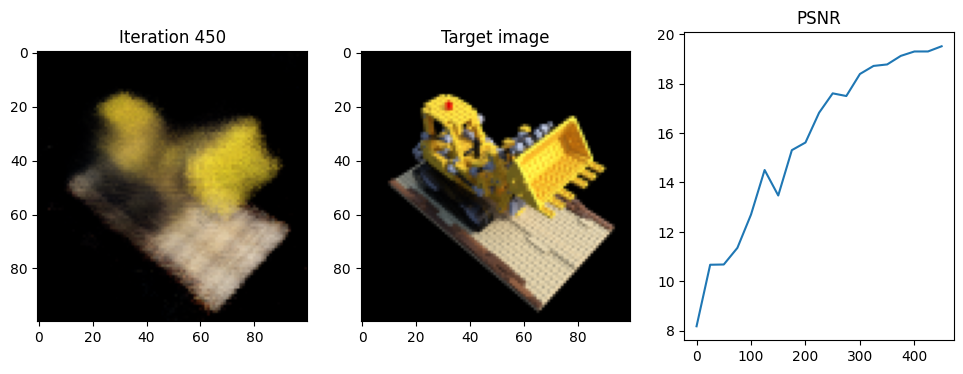

 16%|█▌        | 475/3001 [07:07<35:34,  1.18it/s]

Iteration 475  Loss: 0.0109  PSNR: 19.62  Time: 0.88 secs per iter,  7.26 mins in total


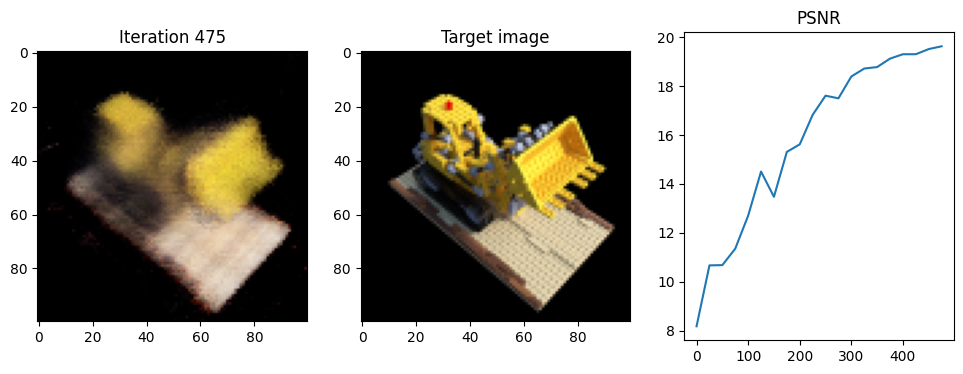

 17%|█▋        | 500/3001 [07:29<35:40,  1.17it/s]

Iteration 500  Loss: 0.0104  PSNR: 19.83  Time: 0.88 secs per iter,  7.63 mins in total


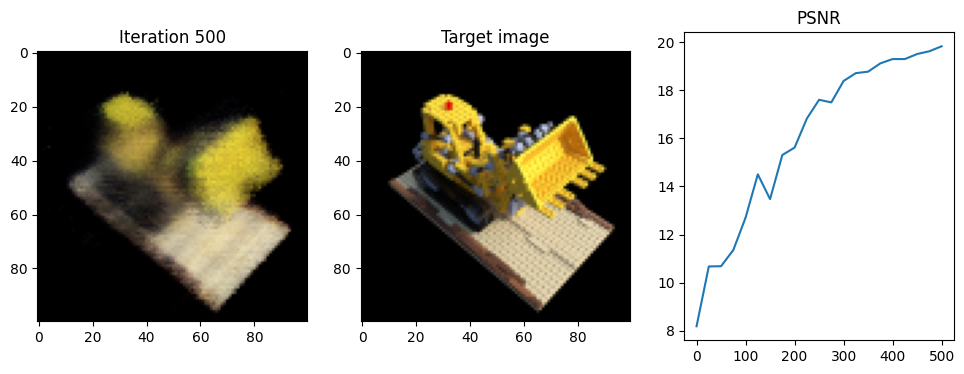

 17%|█▋        | 525/3001 [07:51<34:44,  1.19it/s]

Iteration 525  Loss: 0.0102  PSNR: 19.92  Time: 0.88 secs per iter,  7.99 mins in total


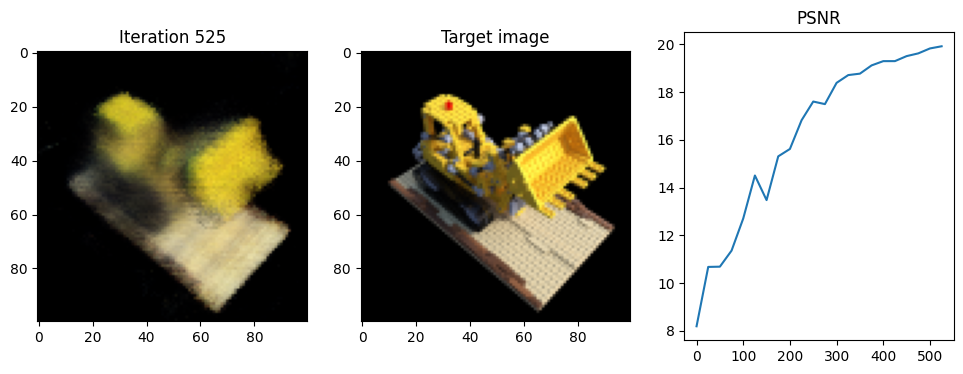

 18%|█▊        | 550/3001 [08:13<34:19,  1.19it/s]

Iteration 550  Loss: 0.0088  PSNR: 20.55  Time: 0.89 secs per iter,  8.36 mins in total


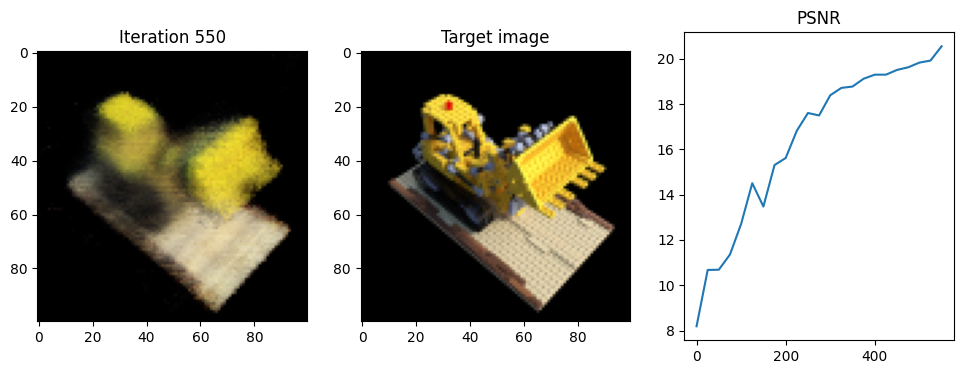

 19%|█▉        | 575/3001 [08:35<33:52,  1.19it/s]

Iteration 575  Loss: 0.0105  PSNR: 19.81  Time: 0.88 secs per iter,  8.73 mins in total


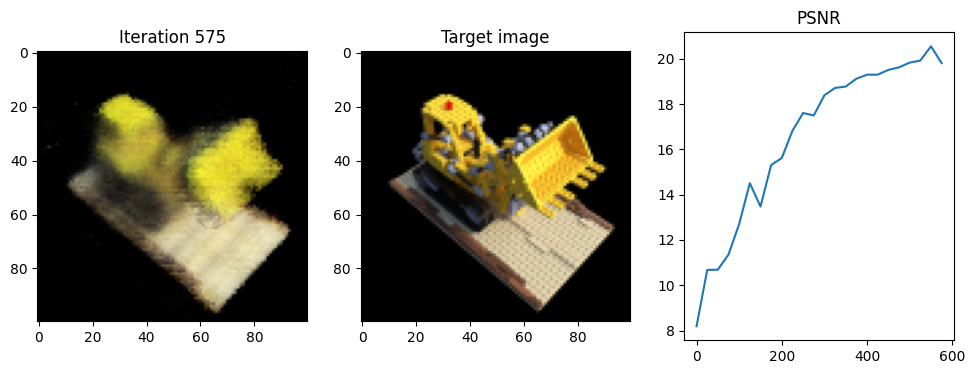

 20%|█▉        | 600/3001 [08:57<33:49,  1.18it/s]

Iteration 600  Loss: 0.0089  PSNR: 20.52  Time: 0.88 secs per iter,  9.09 mins in total


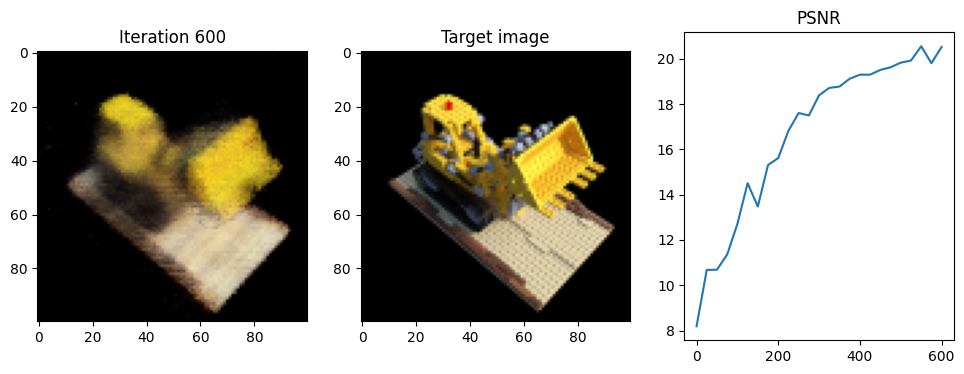

 21%|██        | 625/3001 [09:19<33:27,  1.18it/s]

Iteration 625  Loss: 0.0090  PSNR: 20.44  Time: 0.88 secs per iter,  9.46 mins in total


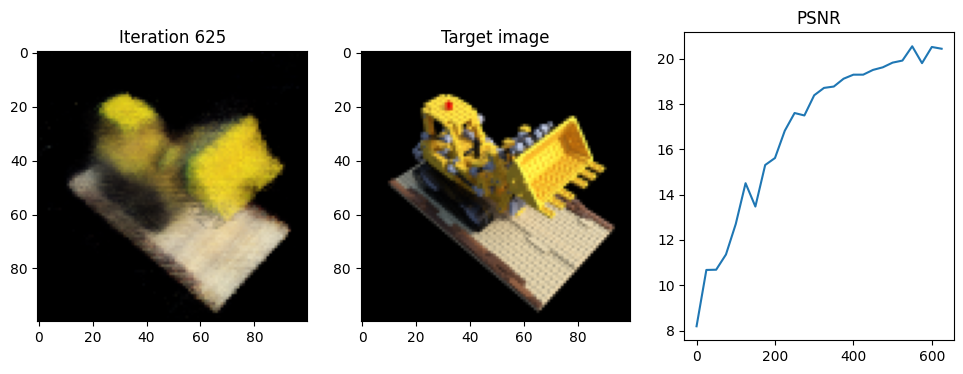

 22%|██▏       | 650/3001 [09:41<32:58,  1.19it/s]

Iteration 650  Loss: 0.0087  PSNR: 20.60  Time: 0.88 secs per iter,  9.83 mins in total


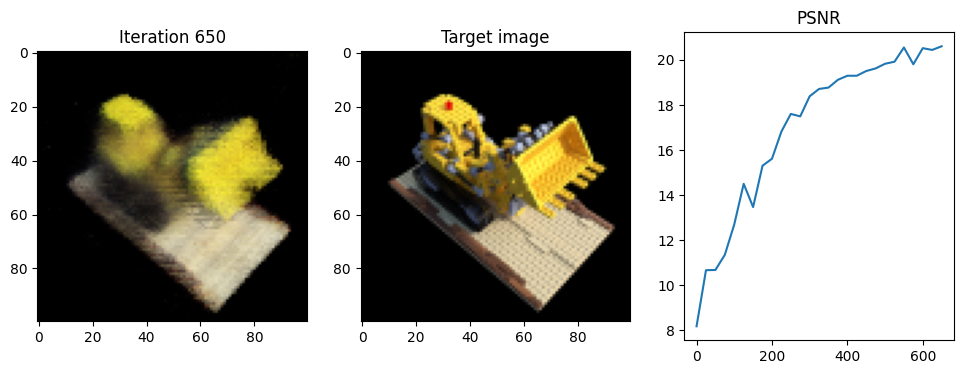

 22%|██▏       | 675/3001 [10:03<32:41,  1.19it/s]

Iteration 675  Loss: 0.0092  PSNR: 20.37  Time: 0.88 secs per iter,  10.19 mins in total


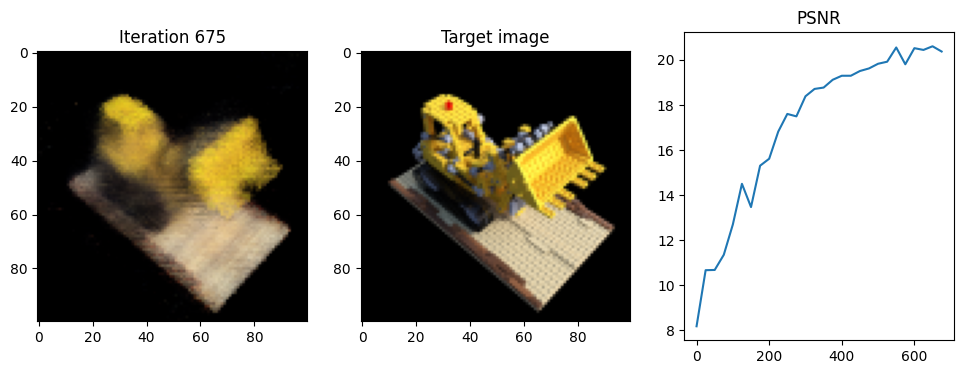

 23%|██▎       | 700/3001 [10:25<32:12,  1.19it/s]

Iteration 700  Loss: 0.0084  PSNR: 20.74  Time: 0.88 secs per iter,  10.56 mins in total


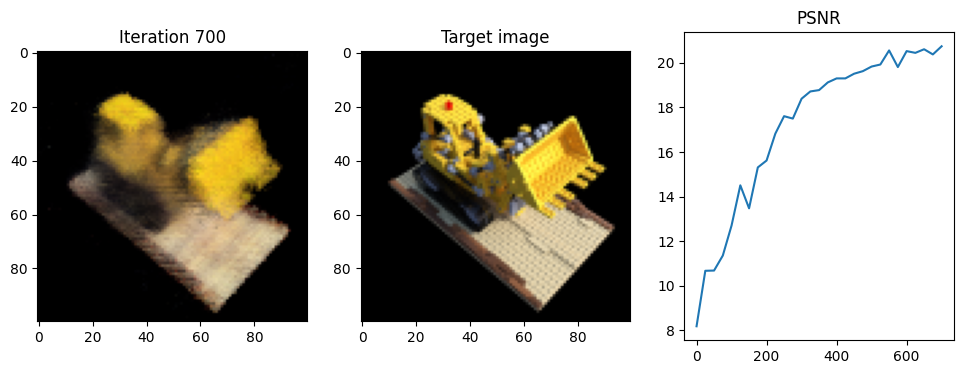

 24%|██▍       | 725/3001 [10:47<32:10,  1.18it/s]

Iteration 725  Loss: 0.0081  PSNR: 20.92  Time: 0.87 secs per iter,  10.92 mins in total


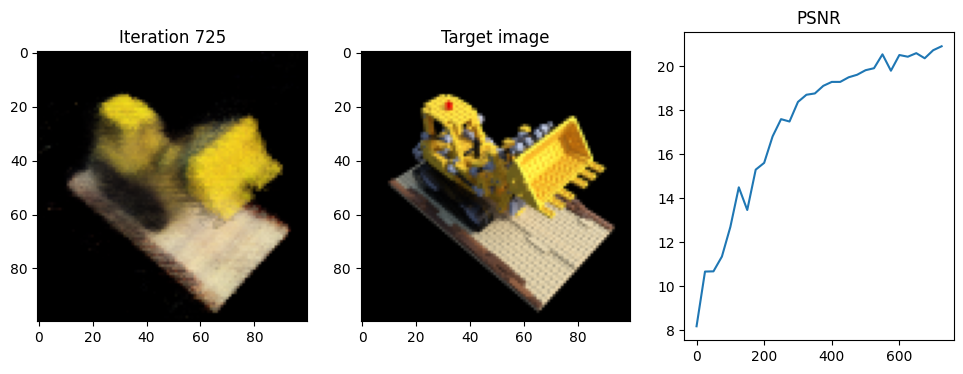

 25%|██▍       | 750/3001 [11:09<31:29,  1.19it/s]

Iteration 750  Loss: 0.0076  PSNR: 21.21  Time: 0.88 secs per iter,  11.29 mins in total


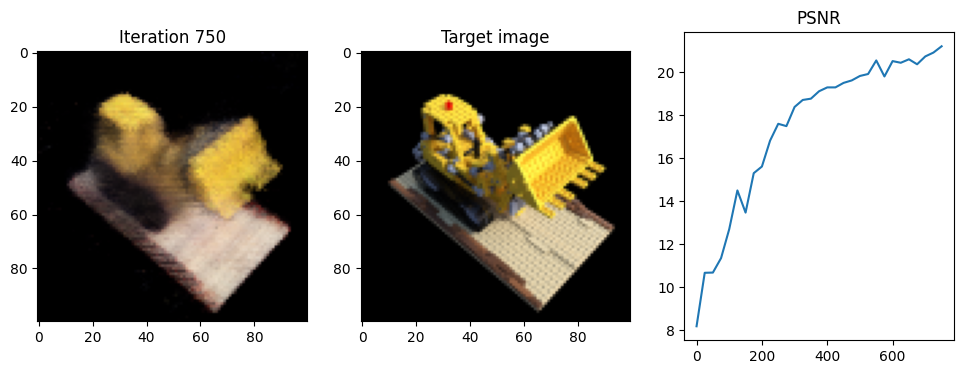

 26%|██▌       | 775/3001 [11:31<31:01,  1.20it/s]

Iteration 775  Loss: 0.0078  PSNR: 21.07  Time: 0.88 secs per iter,  11.66 mins in total


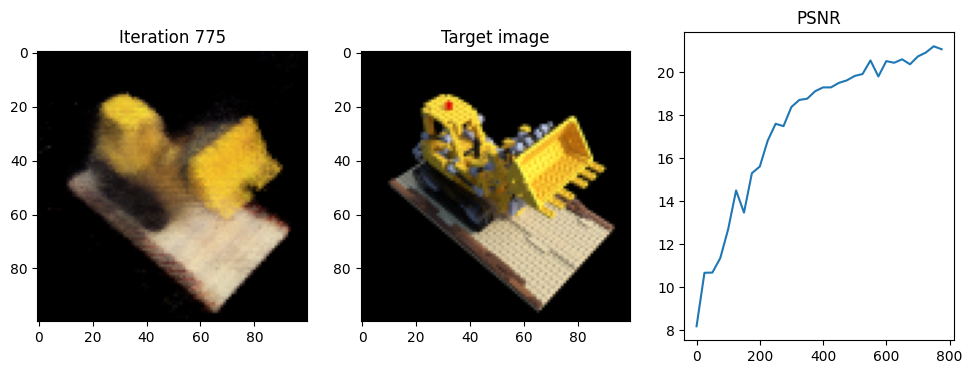

 27%|██▋       | 800/3001 [11:53<30:44,  1.19it/s]

Iteration 800  Loss: 0.0083  PSNR: 20.80  Time: 0.87 secs per iter,  12.02 mins in total


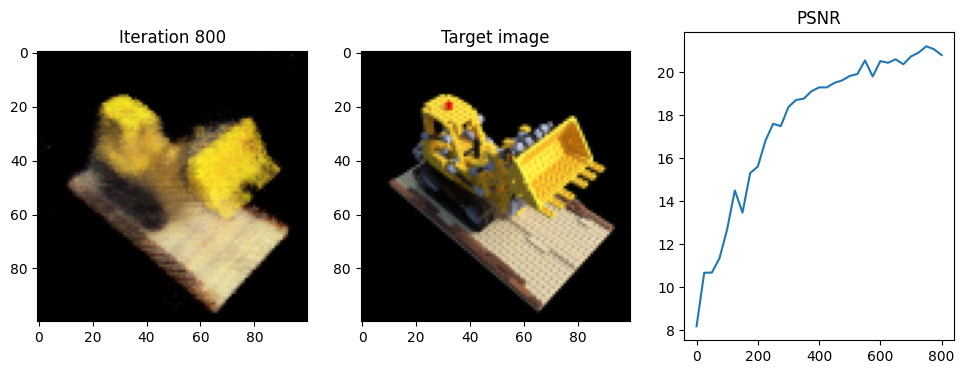

 27%|██▋       | 825/3001 [12:14<30:39,  1.18it/s]

Iteration 825  Loss: 0.0080  PSNR: 20.95  Time: 0.88 secs per iter,  12.38 mins in total


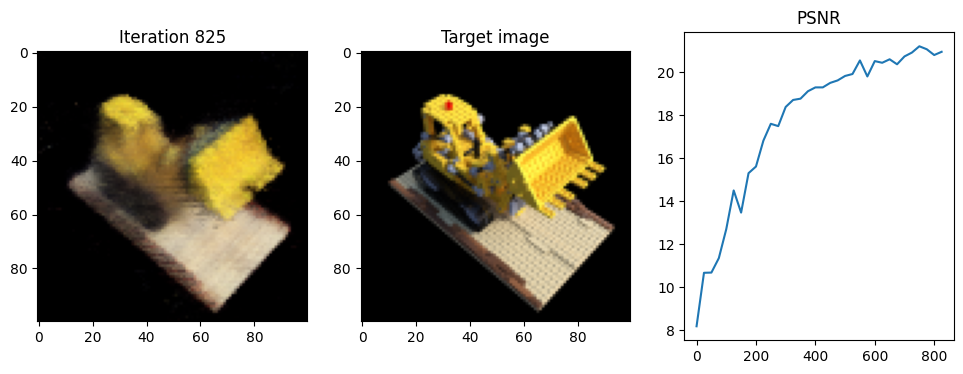

 28%|██▊       | 850/3001 [12:36<30:09,  1.19it/s]

Iteration 850  Loss: 0.0073  PSNR: 21.38  Time: 0.88 secs per iter,  12.75 mins in total


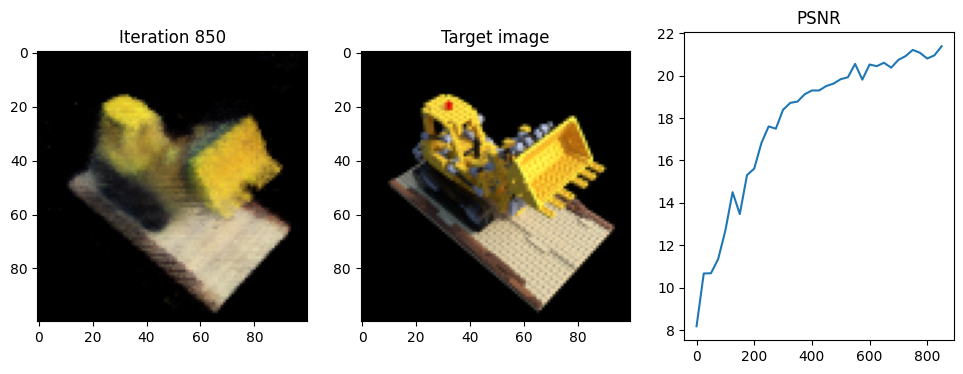

 29%|██▉       | 875/3001 [12:58<29:42,  1.19it/s]

Iteration 875  Loss: 0.0067  PSNR: 21.73  Time: 0.88 secs per iter,  13.11 mins in total


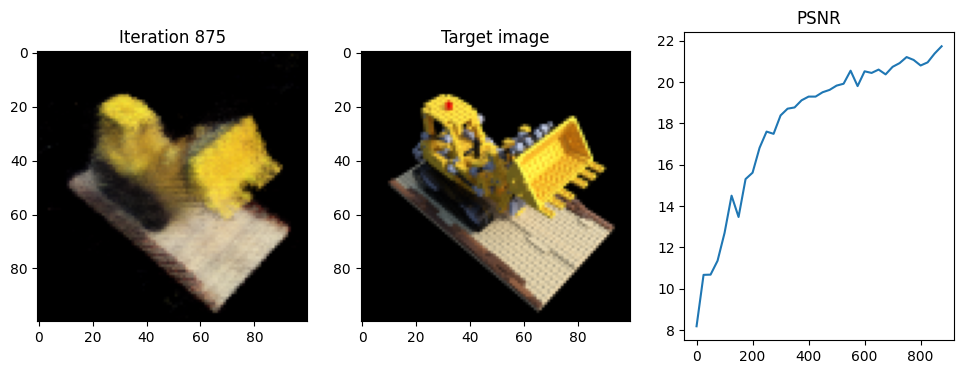

 30%|██▉       | 900/3001 [13:20<29:15,  1.20it/s]

Iteration 900  Loss: 0.0071  PSNR: 21.51  Time: 0.88 secs per iter,  13.48 mins in total


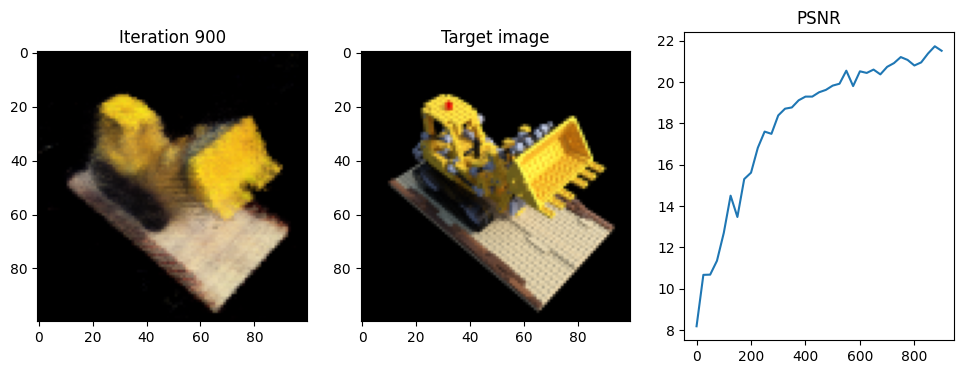

 31%|███       | 925/3001 [13:42<29:05,  1.19it/s]

Iteration 925  Loss: 0.0066  PSNR: 21.80  Time: 0.87 secs per iter,  13.85 mins in total


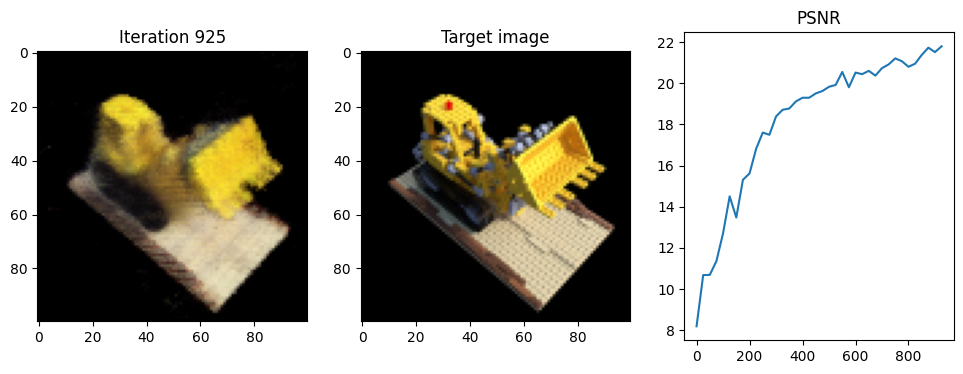

 32%|███▏      | 950/3001 [14:04<28:59,  1.18it/s]

Iteration 950  Loss: 0.0072  PSNR: 21.43  Time: 0.88 secs per iter,  14.21 mins in total


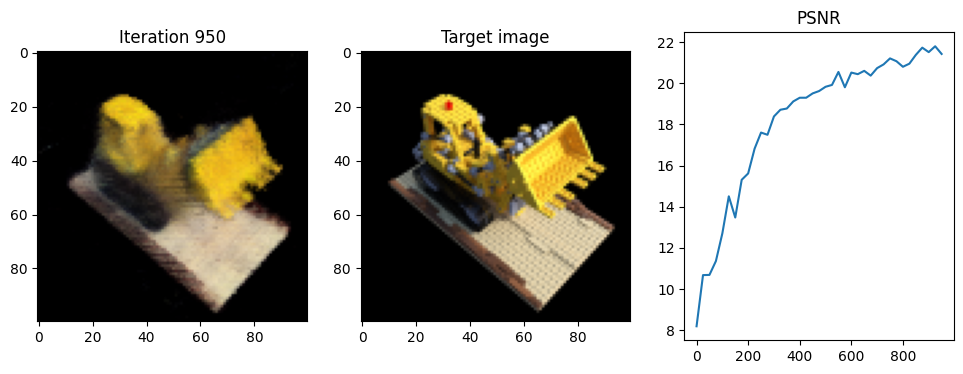

 32%|███▏      | 975/3001 [14:26<28:16,  1.19it/s]

Iteration 975  Loss: 0.0064  PSNR: 21.92  Time: 0.87 secs per iter,  14.58 mins in total


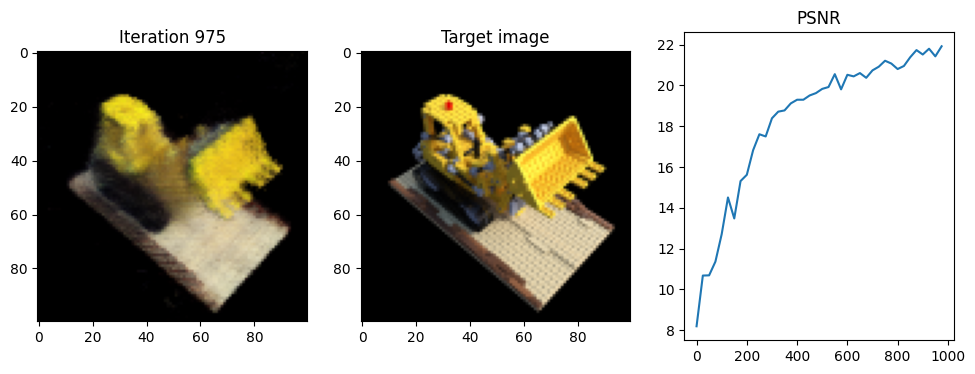

 33%|███▎      | 1000/3001 [14:48<27:31,  1.21it/s]

Iteration 1000  Loss: 0.0064  PSNR: 21.91  Time: 0.88 secs per iter,  14.94 mins in total


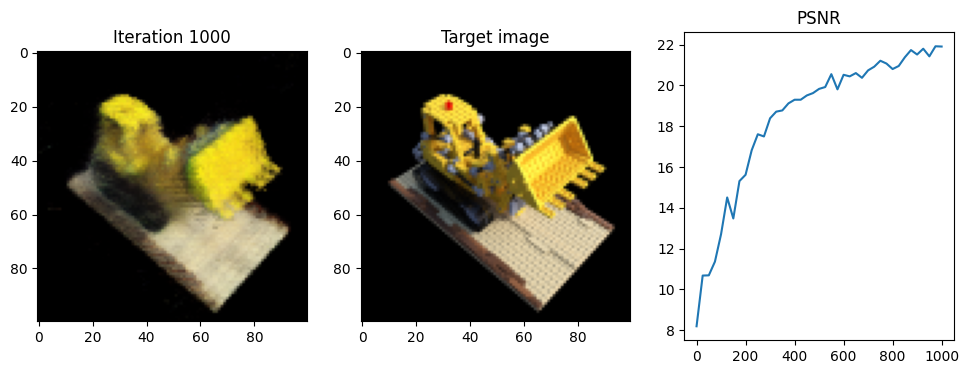

 34%|███▍      | 1025/3001 [15:10<27:50,  1.18it/s]

Iteration 1025  Loss: 0.0069  PSNR: 21.64  Time: 0.88 secs per iter,  15.31 mins in total


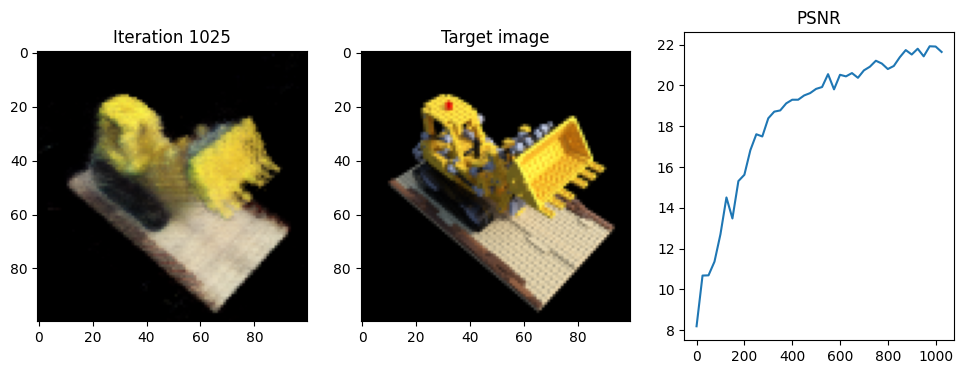

 35%|███▍      | 1050/3001 [15:32<27:38,  1.18it/s]

Iteration 1050  Loss: 0.0066  PSNR: 21.79  Time: 0.88 secs per iter,  15.67 mins in total


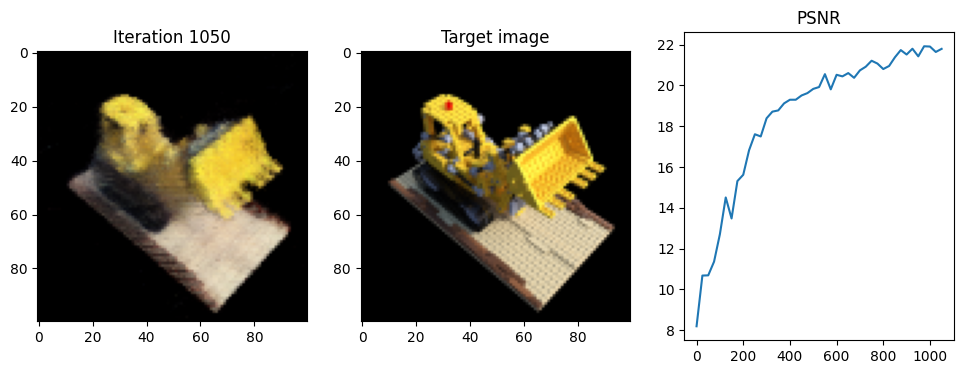

 36%|███▌      | 1075/3001 [15:54<26:50,  1.20it/s]

Iteration 1075  Loss: 0.0068  PSNR: 21.70  Time: 0.87 secs per iter,  16.04 mins in total


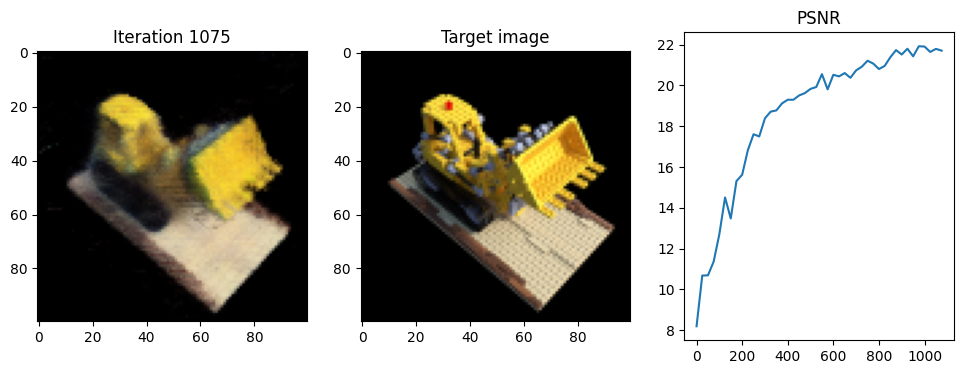

 37%|███▋      | 1100/3001 [16:16<26:29,  1.20it/s]

Iteration 1100  Loss: 0.0062  PSNR: 22.10  Time: 0.89 secs per iter,  16.41 mins in total


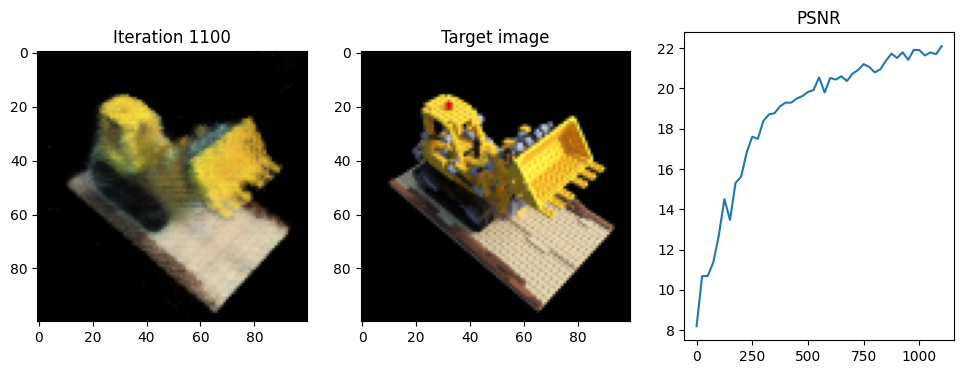

 37%|███▋      | 1125/3001 [16:38<26:12,  1.19it/s]

Iteration 1125  Loss: 0.0059  PSNR: 22.33  Time: 0.87 secs per iter,  16.77 mins in total


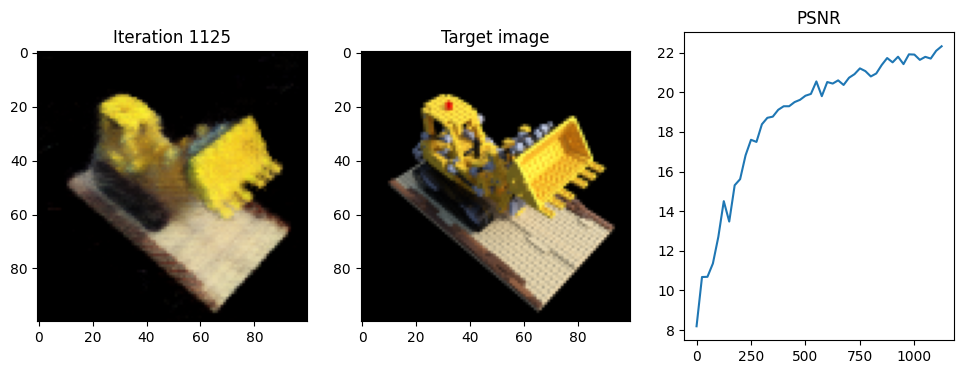

 38%|███▊      | 1150/3001 [16:59<25:54,  1.19it/s]

Iteration 1150  Loss: 0.0059  PSNR: 22.26  Time: 0.87 secs per iter,  17.14 mins in total


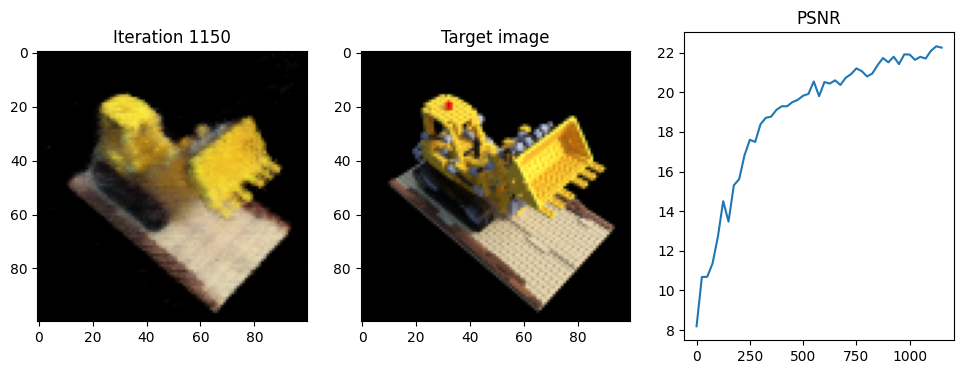

 39%|███▉      | 1175/3001 [17:21<25:48,  1.18it/s]

Iteration 1175  Loss: 0.0066  PSNR: 21.83  Time: 0.87 secs per iter,  17.50 mins in total


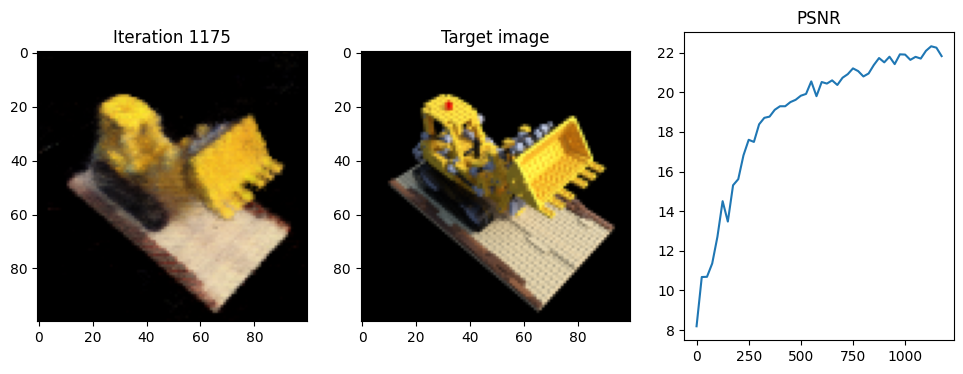

 40%|███▉      | 1200/3001 [17:43<25:09,  1.19it/s]

Iteration 1200  Loss: 0.0058  PSNR: 22.34  Time: 0.87 secs per iter,  17.86 mins in total


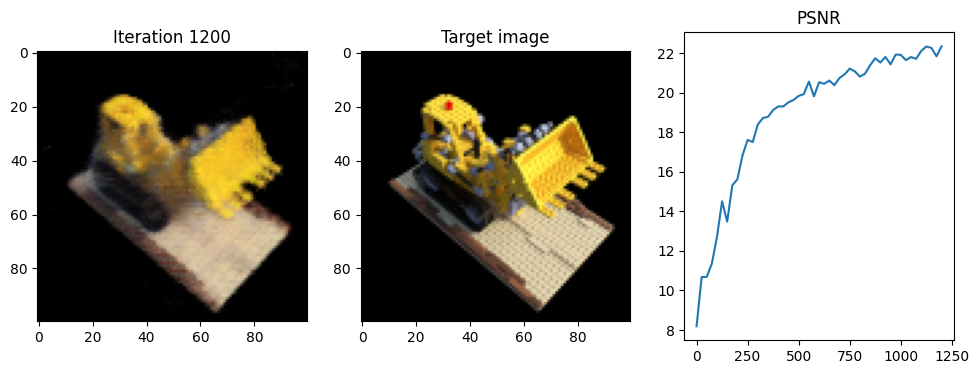

 41%|████      | 1225/3001 [18:05<24:45,  1.20it/s]

Iteration 1225  Loss: 0.0058  PSNR: 22.37  Time: 0.88 secs per iter,  18.23 mins in total


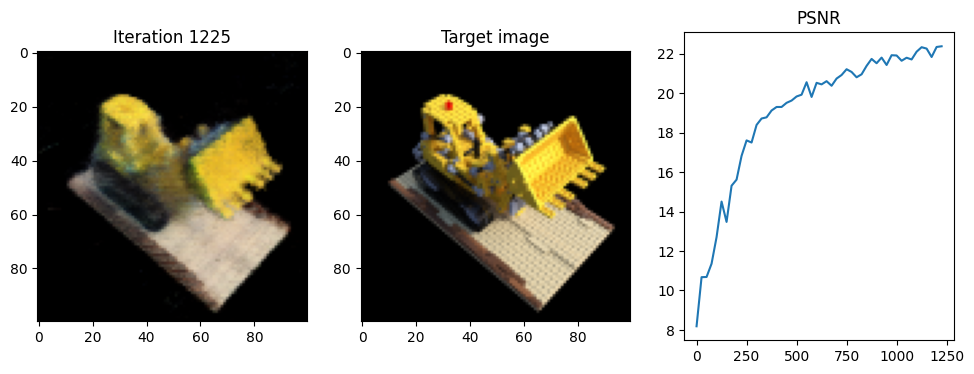

 42%|████▏     | 1250/3001 [18:27<24:26,  1.19it/s]

Iteration 1250  Loss: 0.0053  PSNR: 22.78  Time: 0.88 secs per iter,  18.60 mins in total


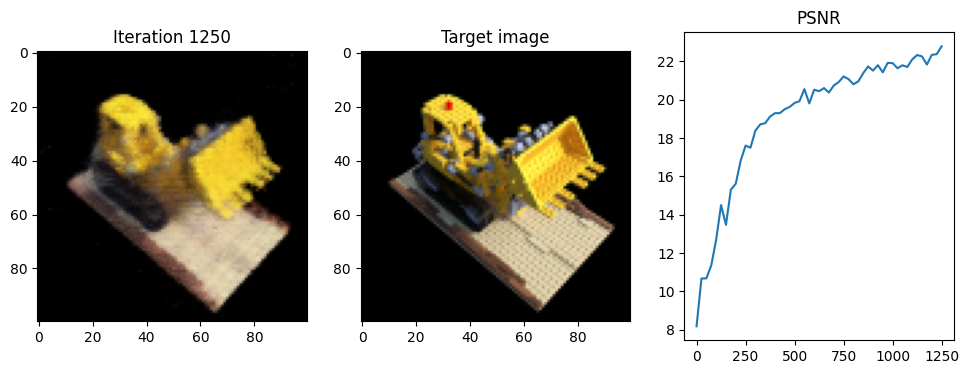

 42%|████▏     | 1275/3001 [18:49<24:13,  1.19it/s]

Iteration 1275  Loss: 0.0055  PSNR: 22.62  Time: 0.88 secs per iter,  18.96 mins in total


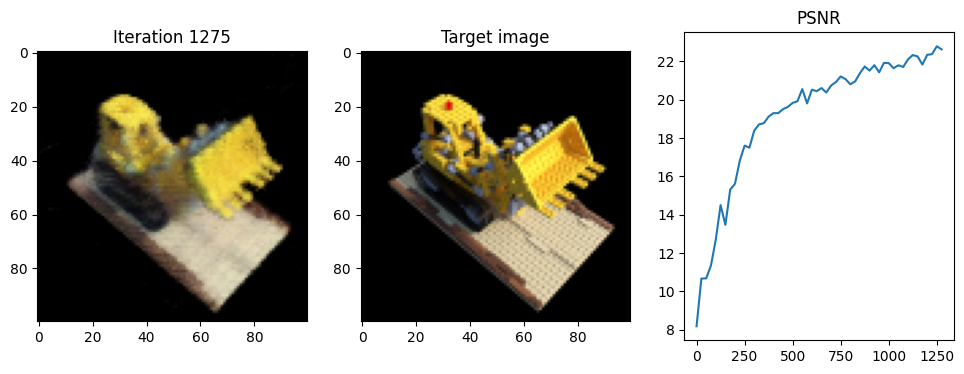

 43%|████▎     | 1300/3001 [19:11<23:57,  1.18it/s]

Iteration 1300  Loss: 0.0059  PSNR: 22.26  Time: 0.88 secs per iter,  19.33 mins in total


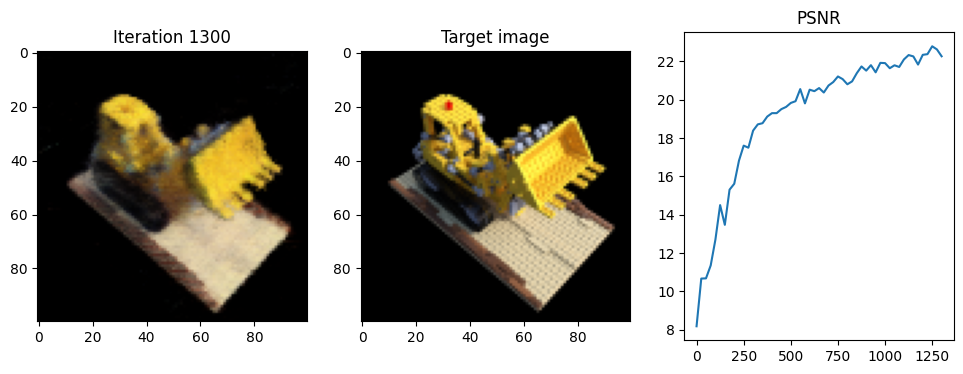

 44%|████▍     | 1325/3001 [19:33<23:22,  1.20it/s]

Iteration 1325  Loss: 0.0059  PSNR: 22.30  Time: 0.88 secs per iter,  19.70 mins in total


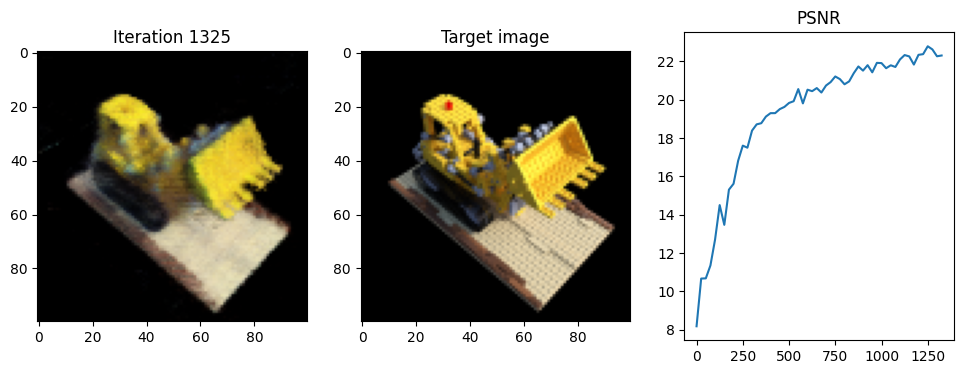

 45%|████▍     | 1350/3001 [19:55<22:58,  1.20it/s]

Iteration 1350  Loss: 0.0062  PSNR: 22.10  Time: 0.88 secs per iter,  20.07 mins in total


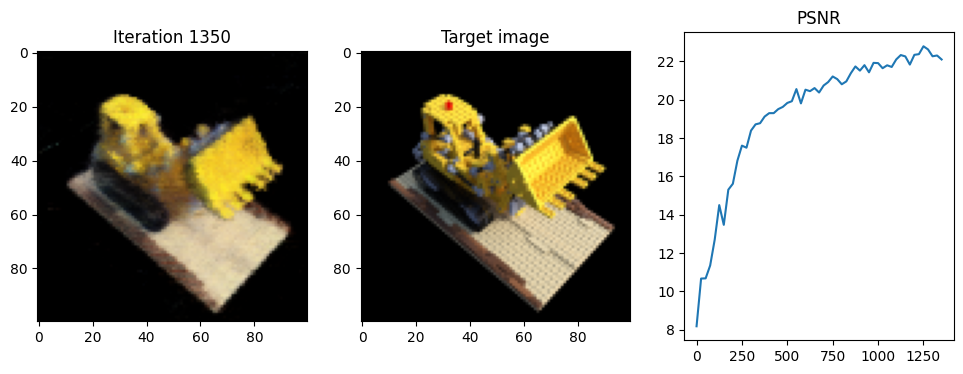

 46%|████▌     | 1375/3001 [20:17<22:43,  1.19it/s]

Iteration 1375  Loss: 0.0050  PSNR: 23.02  Time: 0.88 secs per iter,  20.43 mins in total


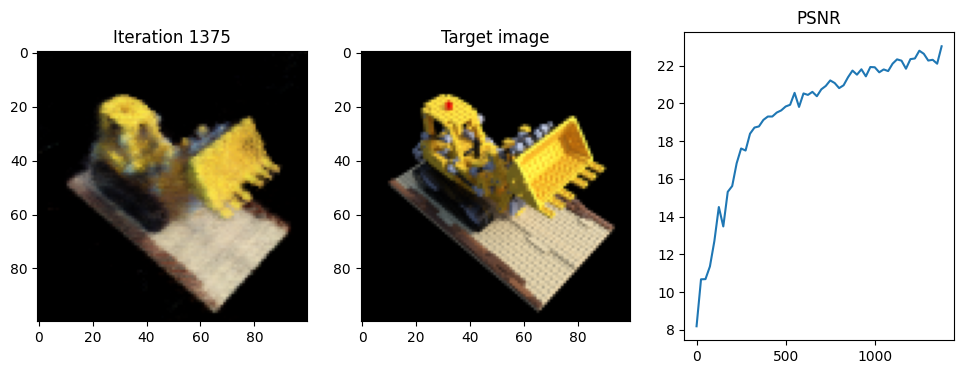

 47%|████▋     | 1400/3001 [20:39<22:30,  1.19it/s]

Iteration 1400  Loss: 0.0050  PSNR: 23.02  Time: 0.87 secs per iter,  20.79 mins in total


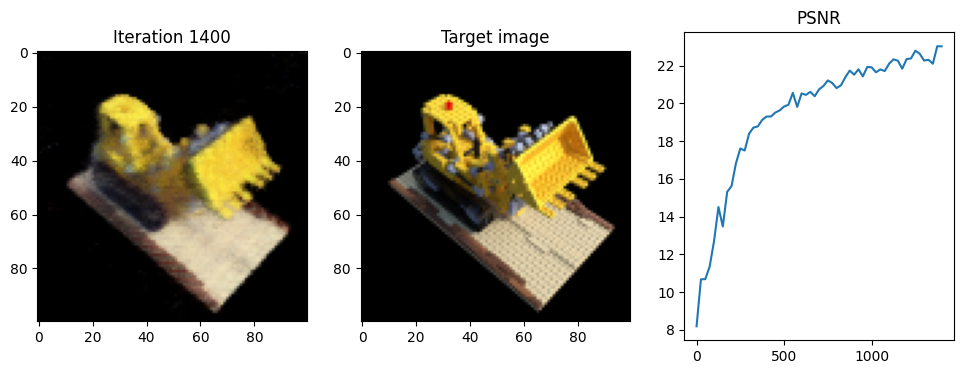

 47%|████▋     | 1425/3001 [21:01<21:57,  1.20it/s]

Iteration 1425  Loss: 0.0058  PSNR: 22.38  Time: 0.87 secs per iter,  21.16 mins in total


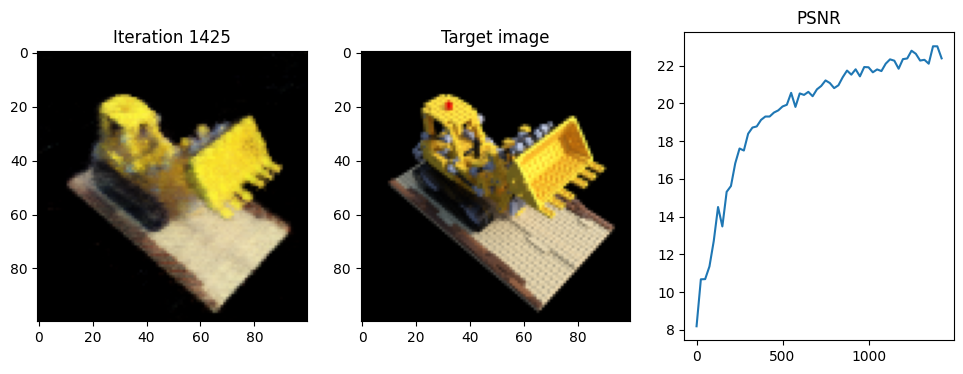

 48%|████▊     | 1450/3001 [21:23<21:31,  1.20it/s]

Iteration 1450  Loss: 0.0062  PSNR: 22.07  Time: 0.88 secs per iter,  21.52 mins in total


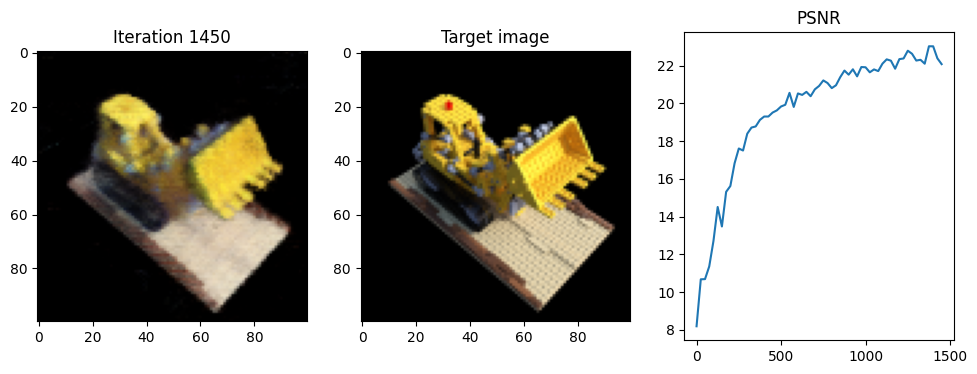

 49%|████▉     | 1475/3001 [21:45<21:15,  1.20it/s]

Iteration 1475  Loss: 0.0049  PSNR: 23.10  Time: 0.88 secs per iter,  21.89 mins in total


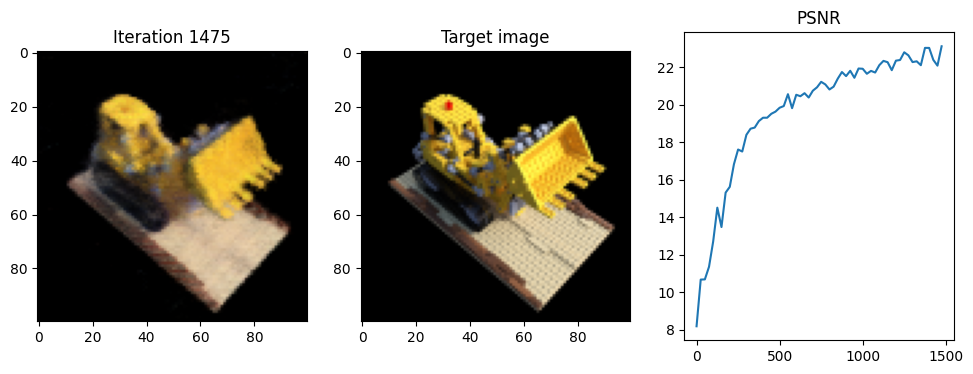

 50%|████▉     | 1500/3001 [22:07<21:01,  1.19it/s]

Iteration 1500  Loss: 0.0058  PSNR: 22.35  Time: 0.88 secs per iter,  22.25 mins in total


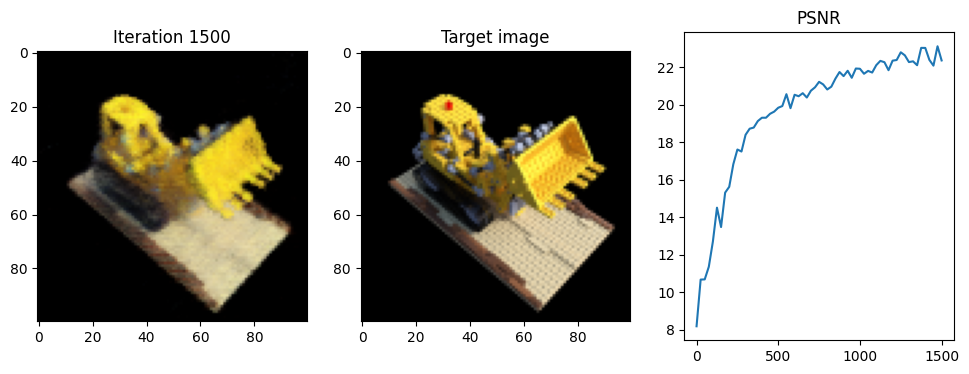

 51%|█████     | 1525/3001 [22:29<20:47,  1.18it/s]

Iteration 1525  Loss: 0.0052  PSNR: 22.85  Time: 0.88 secs per iter,  22.62 mins in total


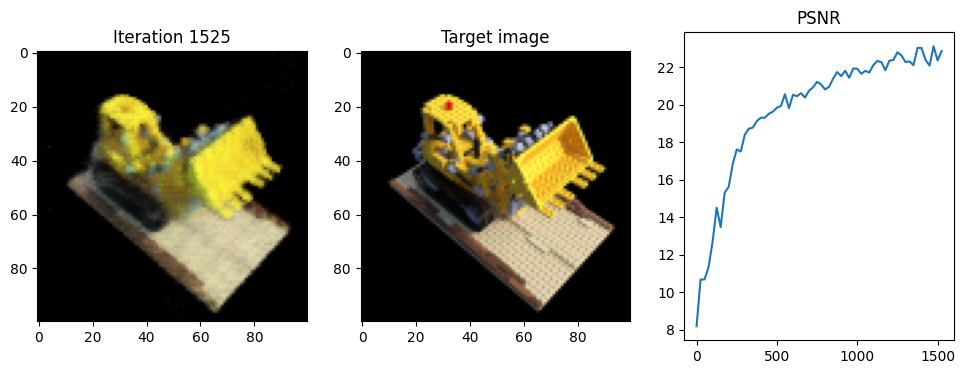

 52%|█████▏    | 1550/3001 [22:50<20:16,  1.19it/s]

Iteration 1550  Loss: 0.0058  PSNR: 22.40  Time: 0.87 secs per iter,  22.99 mins in total


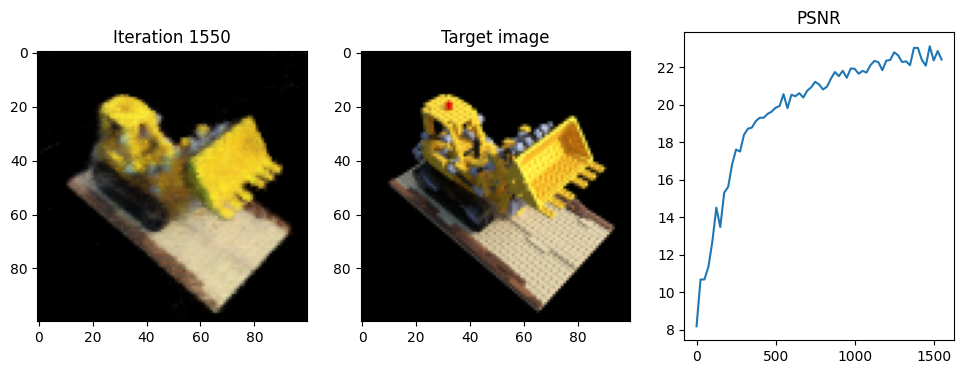

 52%|█████▏    | 1575/3001 [23:13<19:57,  1.19it/s]

Iteration 1575  Loss: 0.0045  PSNR: 23.43  Time: 0.88 secs per iter,  23.35 mins in total


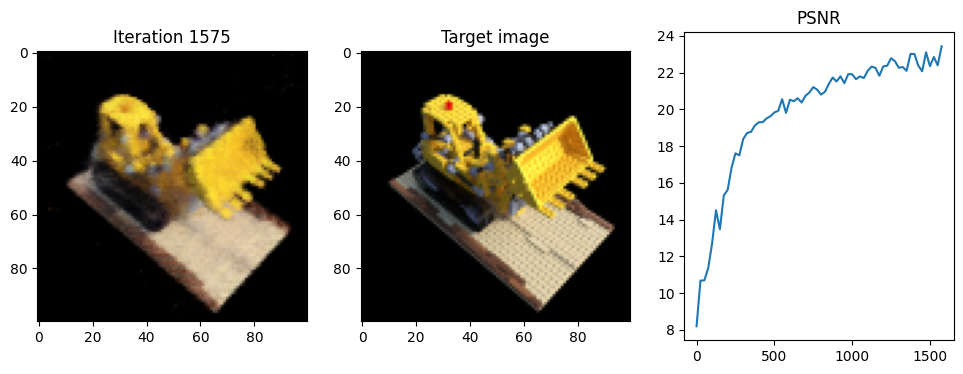

 53%|█████▎    | 1600/3001 [23:34<19:37,  1.19it/s]

Iteration 1600  Loss: 0.0043  PSNR: 23.62  Time: 0.88 secs per iter,  23.72 mins in total


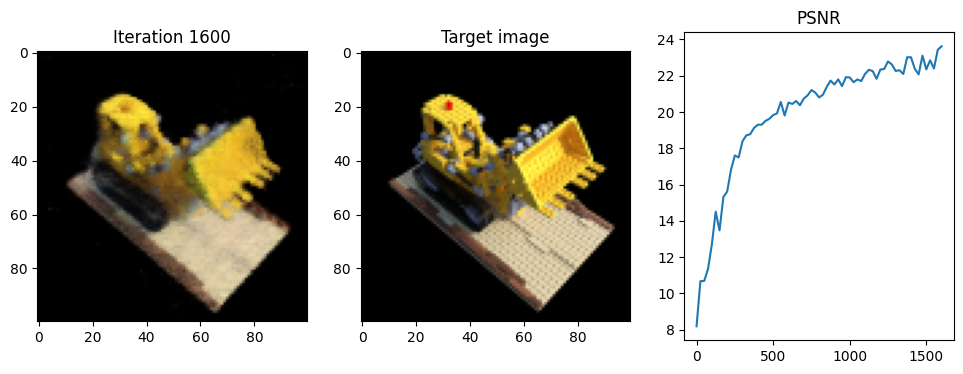

 54%|█████▍    | 1625/3001 [23:56<19:29,  1.18it/s]

Iteration 1625  Loss: 0.0052  PSNR: 22.86  Time: 0.88 secs per iter,  24.08 mins in total


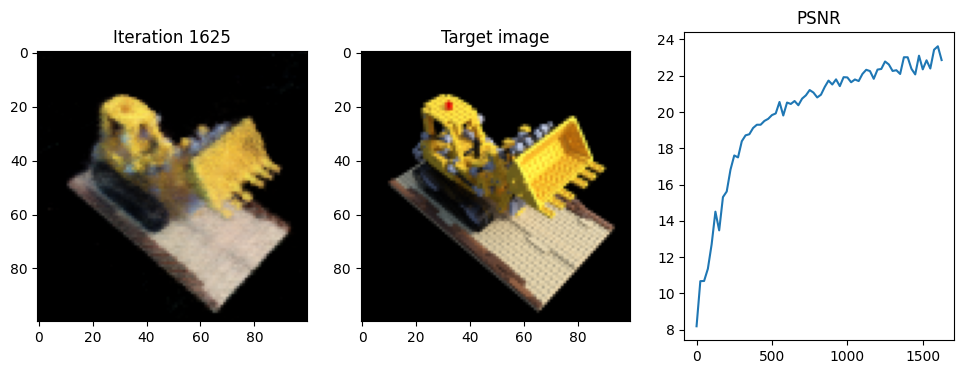

 55%|█████▍    | 1650/3001 [24:18<18:51,  1.19it/s]

Iteration 1650  Loss: 0.0048  PSNR: 23.21  Time: 0.88 secs per iter,  24.45 mins in total


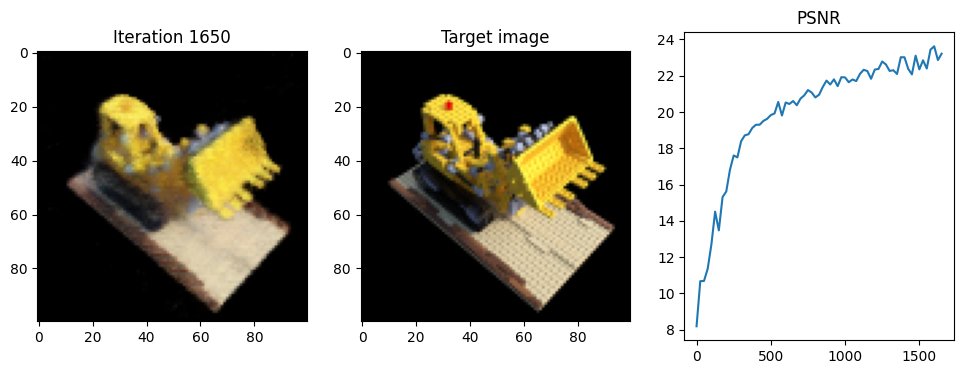

 56%|█████▌    | 1675/3001 [24:40<18:33,  1.19it/s]

Iteration 1675  Loss: 0.0055  PSNR: 22.60  Time: 0.88 secs per iter,  24.82 mins in total


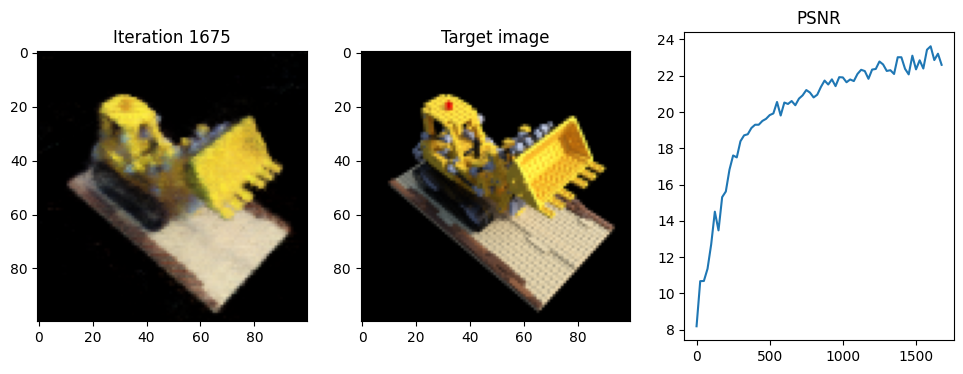

 57%|█████▋    | 1700/3001 [25:02<18:00,  1.20it/s]

Iteration 1700  Loss: 0.0045  PSNR: 23.42  Time: 0.87 secs per iter,  25.18 mins in total


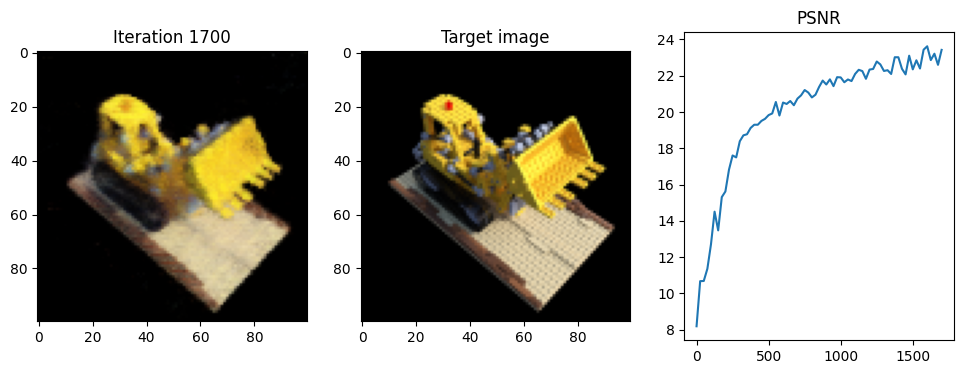

 57%|█████▋    | 1725/3001 [25:24<17:54,  1.19it/s]

Iteration 1725  Loss: 0.0045  PSNR: 23.52  Time: 0.88 secs per iter,  25.55 mins in total


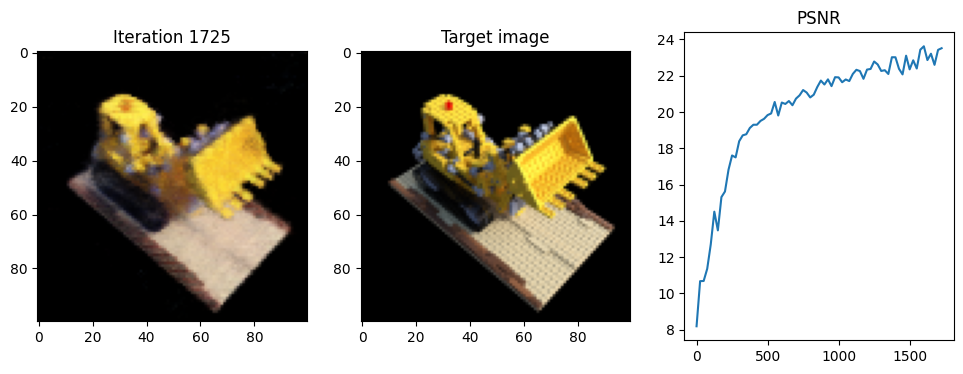

 58%|█████▊    | 1750/3001 [25:46<17:32,  1.19it/s]

Iteration 1750  Loss: 0.0057  PSNR: 22.47  Time: 0.88 secs per iter,  25.91 mins in total


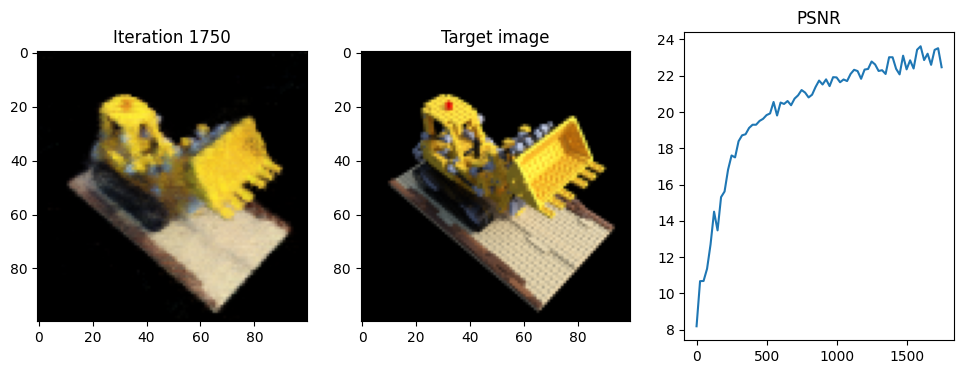

 59%|█████▉    | 1775/3001 [26:08<17:04,  1.20it/s]

Iteration 1775  Loss: 0.0043  PSNR: 23.69  Time: 0.87 secs per iter,  26.27 mins in total


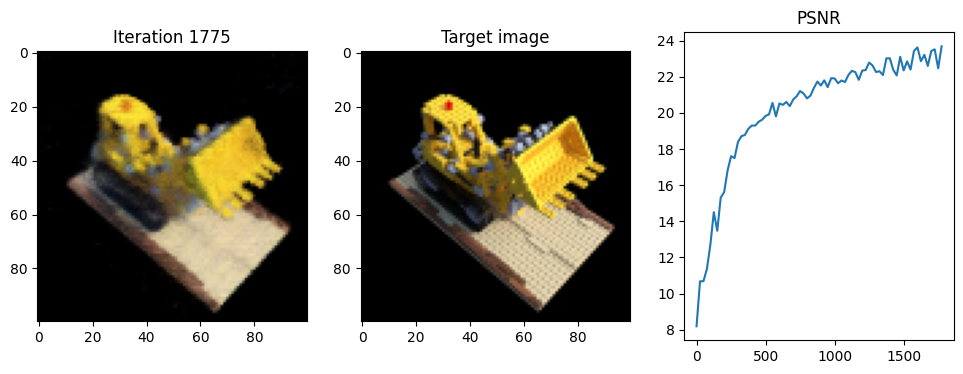

 60%|█████▉    | 1800/3001 [26:30<16:45,  1.19it/s]

Iteration 1800  Loss: 0.0049  PSNR: 23.06  Time: 0.88 secs per iter,  26.64 mins in total


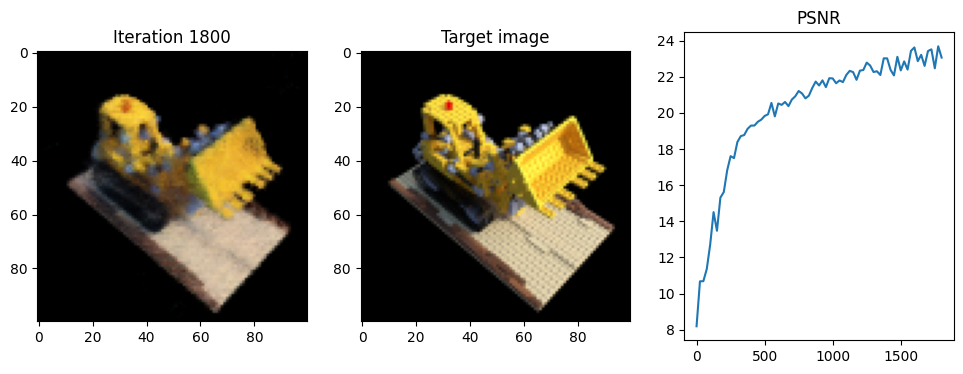

 61%|██████    | 1825/3001 [26:52<16:27,  1.19it/s]

Iteration 1825  Loss: 0.0040  PSNR: 23.93  Time: 0.88 secs per iter,  27.01 mins in total


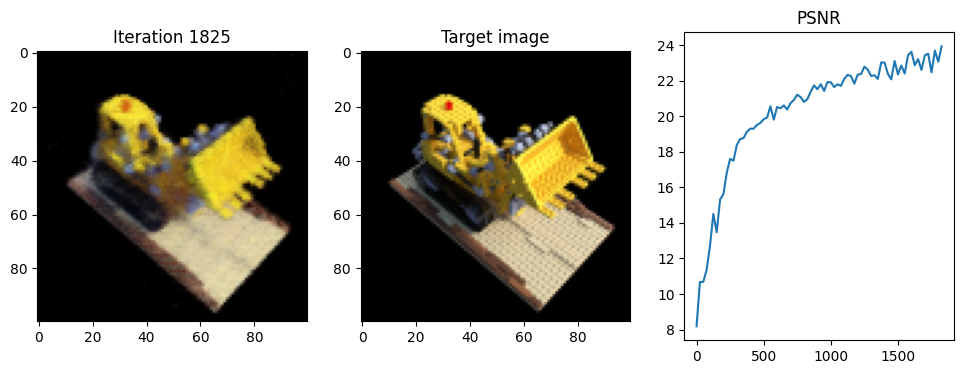

 62%|██████▏   | 1850/3001 [27:14<16:07,  1.19it/s]

Iteration 1850  Loss: 0.0043  PSNR: 23.65  Time: 0.88 secs per iter,  27.37 mins in total


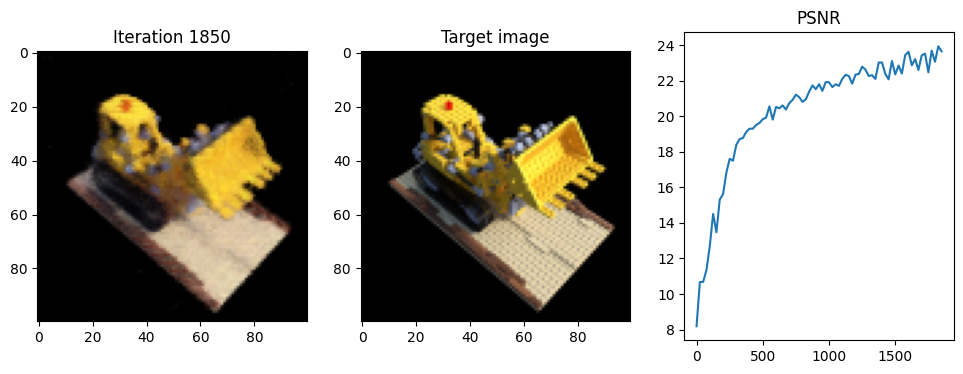

 62%|██████▏   | 1875/3001 [27:35<15:39,  1.20it/s]

Iteration 1875  Loss: 0.0042  PSNR: 23.75  Time: 0.87 secs per iter,  27.73 mins in total


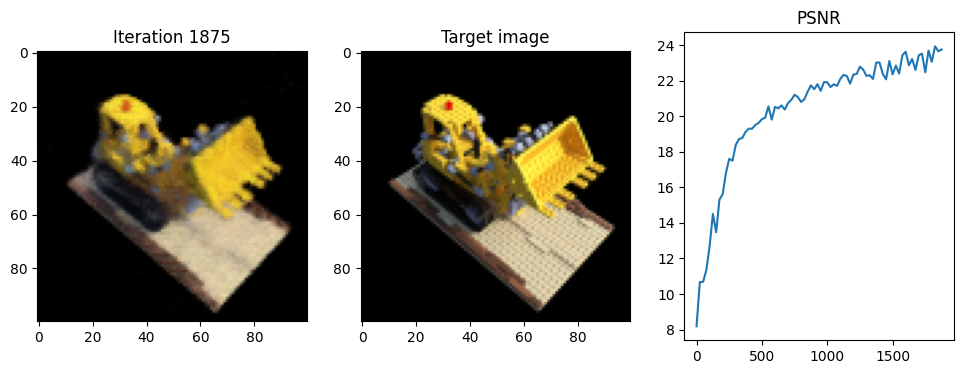

 63%|██████▎   | 1900/3001 [27:57<15:16,  1.20it/s]

Iteration 1900  Loss: 0.0043  PSNR: 23.71  Time: 0.88 secs per iter,  28.10 mins in total


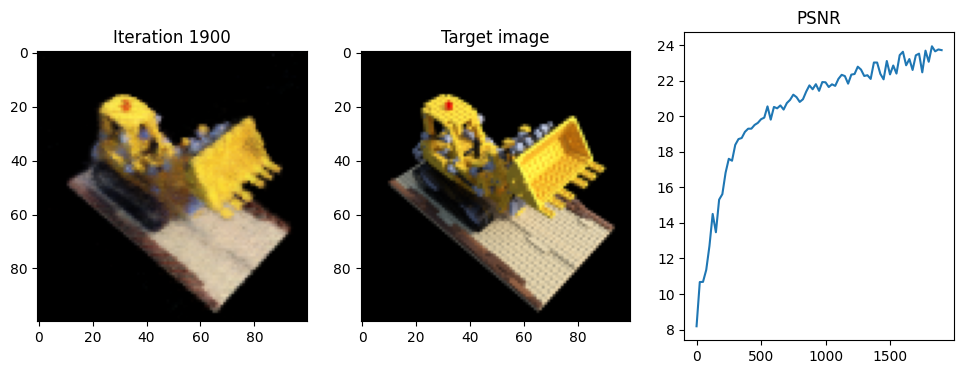

 64%|██████▍   | 1925/3001 [28:19<14:57,  1.20it/s]

Iteration 1925  Loss: 0.0043  PSNR: 23.69  Time: 0.87 secs per iter,  28.46 mins in total


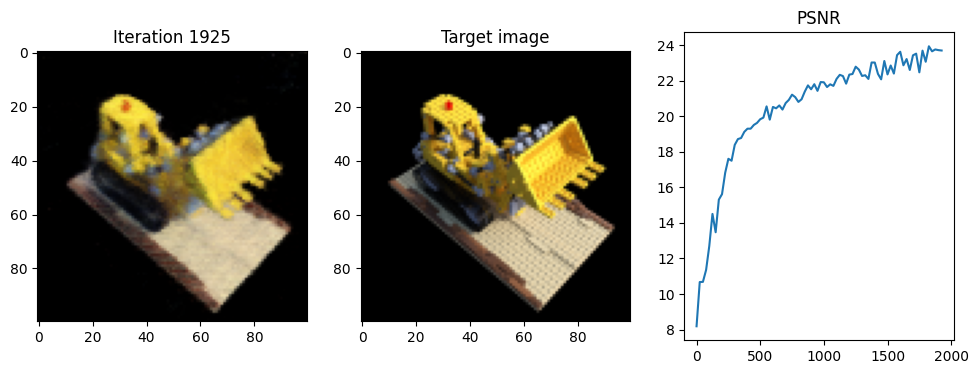

 65%|██████▍   | 1950/3001 [28:41<14:42,  1.19it/s]

Iteration 1950  Loss: 0.0044  PSNR: 23.56  Time: 0.87 secs per iter,  28.83 mins in total


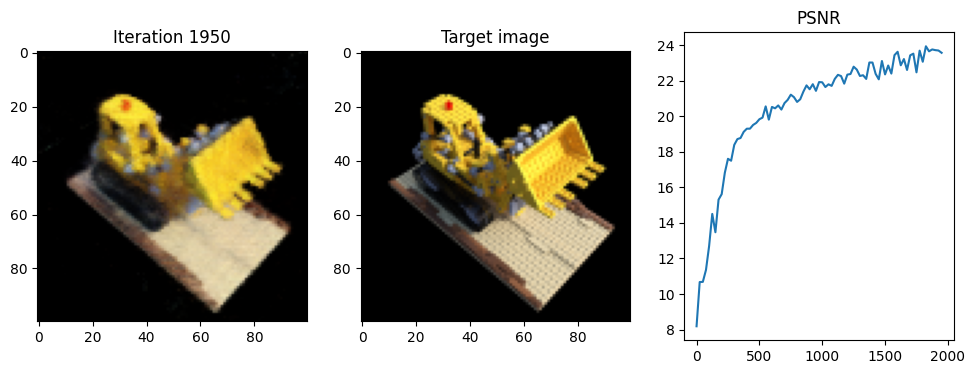

 66%|██████▌   | 1975/3001 [29:03<14:18,  1.20it/s]

Iteration 1975  Loss: 0.0046  PSNR: 23.38  Time: 0.88 secs per iter,  29.19 mins in total


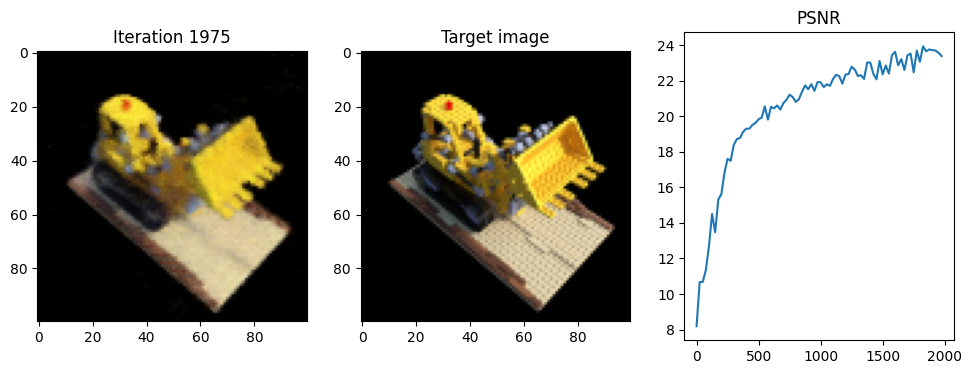

 67%|██████▋   | 2000/3001 [29:25<13:56,  1.20it/s]

Iteration 2000  Loss: 0.0040  PSNR: 24.02  Time: 0.88 secs per iter,  29.56 mins in total


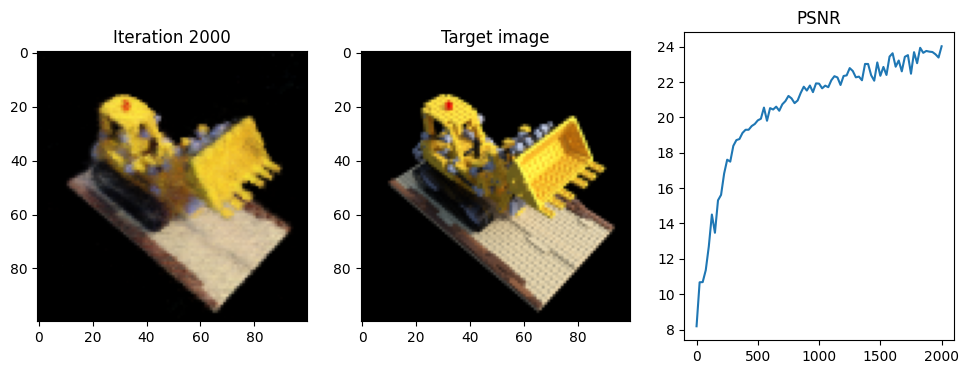

 67%|██████▋   | 2025/3001 [29:47<13:39,  1.19it/s]

Iteration 2025  Loss: 0.0044  PSNR: 23.57  Time: 0.87 secs per iter,  29.92 mins in total


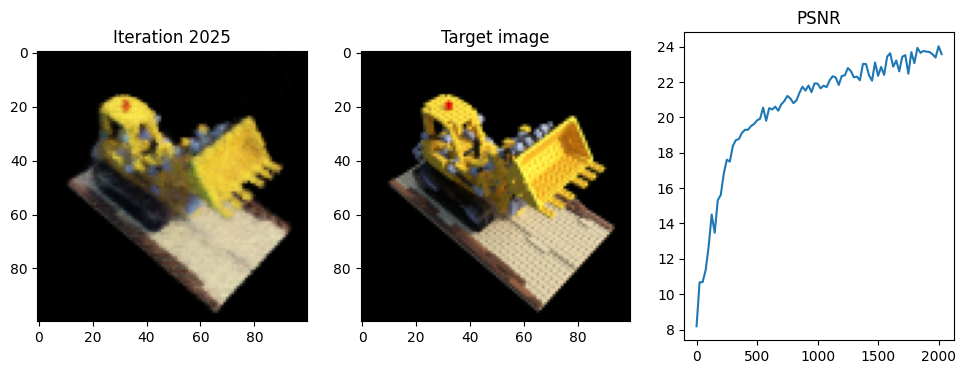

 68%|██████▊   | 2050/3001 [30:09<13:07,  1.21it/s]

Iteration 2050  Loss: 0.0047  PSNR: 23.33  Time: 0.87 secs per iter,  30.29 mins in total


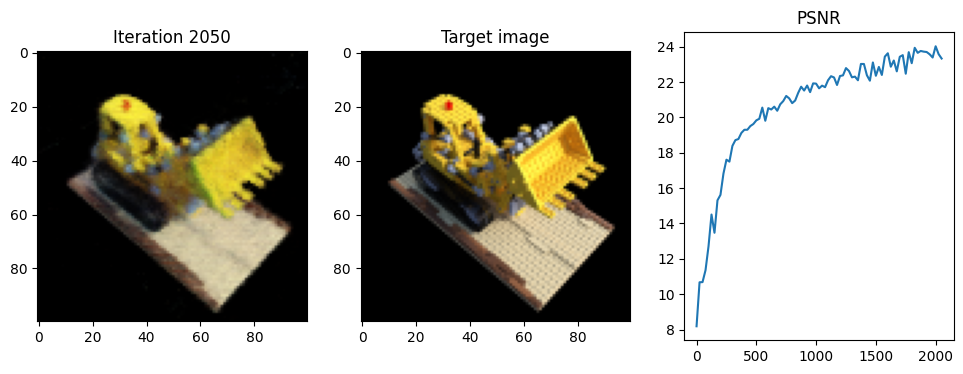

 69%|██████▉   | 2075/3001 [30:30<12:54,  1.20it/s]

Iteration 2075  Loss: 0.0048  PSNR: 23.22  Time: 0.87 secs per iter,  30.65 mins in total


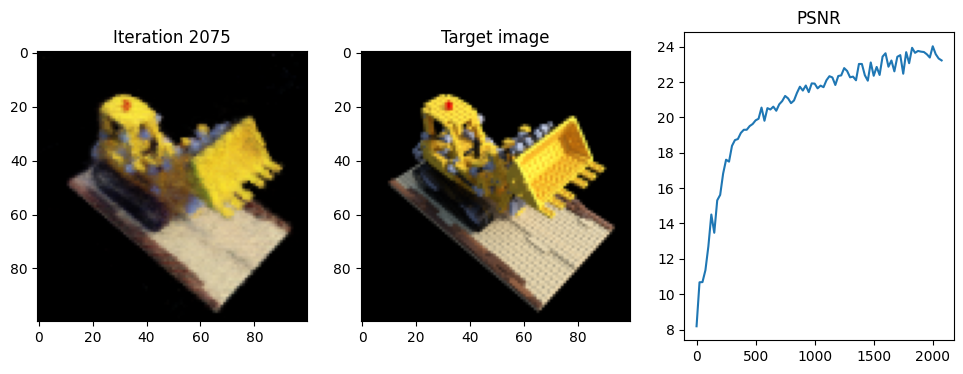

 70%|██████▉   | 2100/3001 [30:52<12:35,  1.19it/s]

Iteration 2100  Loss: 0.0040  PSNR: 23.99  Time: 0.88 secs per iter,  31.02 mins in total


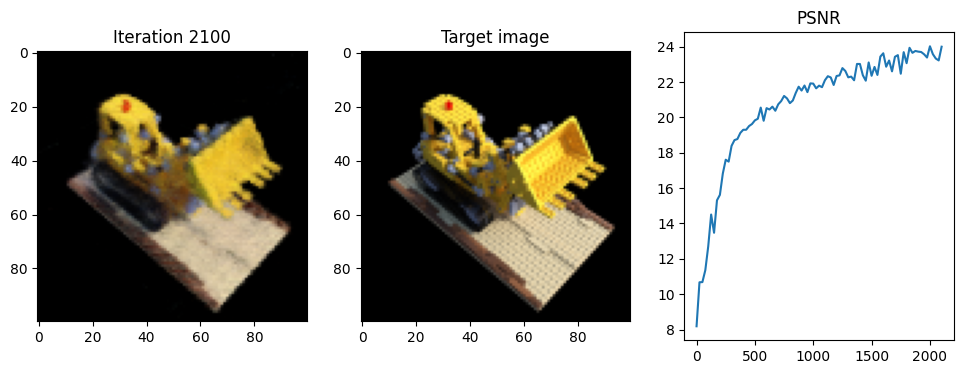

 71%|███████   | 2125/3001 [31:14<12:17,  1.19it/s]

Iteration 2125  Loss: 0.0039  PSNR: 24.07  Time: 0.88 secs per iter,  31.38 mins in total


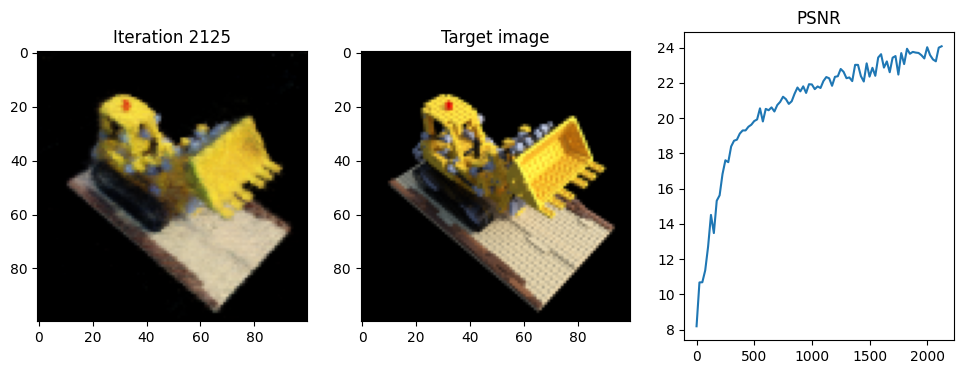

 72%|███████▏  | 2150/3001 [31:36<11:56,  1.19it/s]

Iteration 2150  Loss: 0.0047  PSNR: 23.28  Time: 0.88 secs per iter,  31.75 mins in total


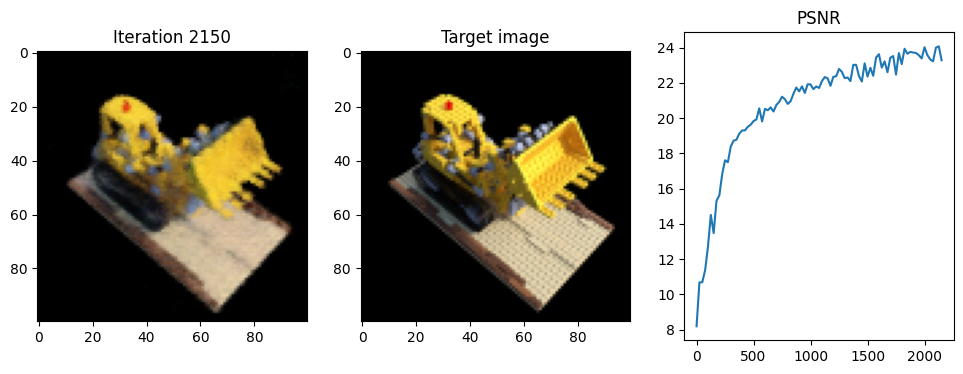

 72%|███████▏  | 2175/3001 [31:58<11:29,  1.20it/s]

Iteration 2175  Loss: 0.0040  PSNR: 24.02  Time: 0.87 secs per iter,  32.11 mins in total


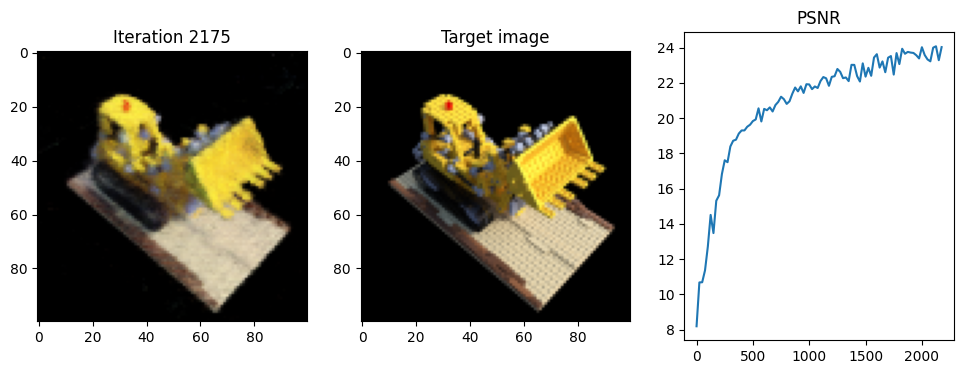

 73%|███████▎  | 2200/3001 [32:20<11:09,  1.20it/s]

Iteration 2200  Loss: 0.0048  PSNR: 23.23  Time: 0.89 secs per iter,  32.48 mins in total


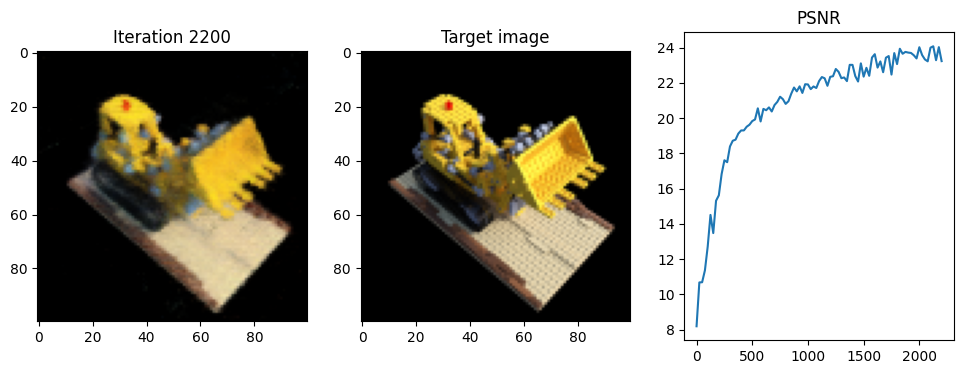

 74%|███████▍  | 2225/3001 [32:42<10:51,  1.19it/s]

Iteration 2225  Loss: 0.0034  PSNR: 24.66  Time: 0.88 secs per iter,  32.84 mins in total


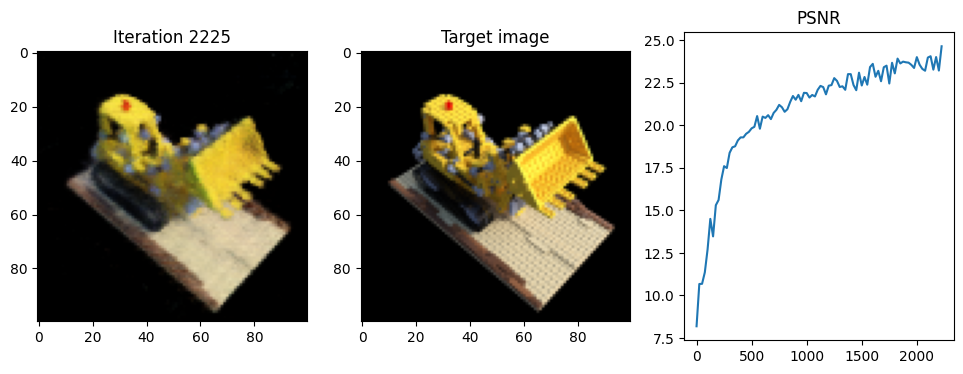

 75%|███████▍  | 2250/3001 [33:04<10:31,  1.19it/s]

Iteration 2250  Loss: 0.0042  PSNR: 23.76  Time: 0.87 secs per iter,  33.21 mins in total


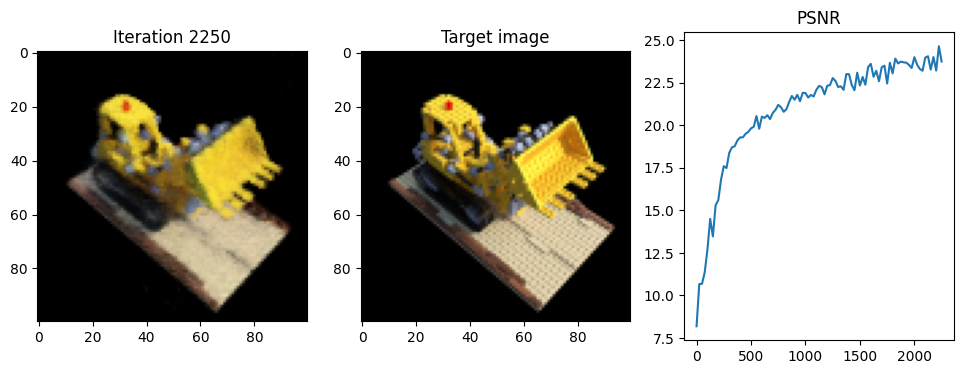

 76%|███████▌  | 2275/3001 [33:26<10:07,  1.20it/s]

Iteration 2275  Loss: 0.0040  PSNR: 23.94  Time: 0.87 secs per iter,  33.57 mins in total


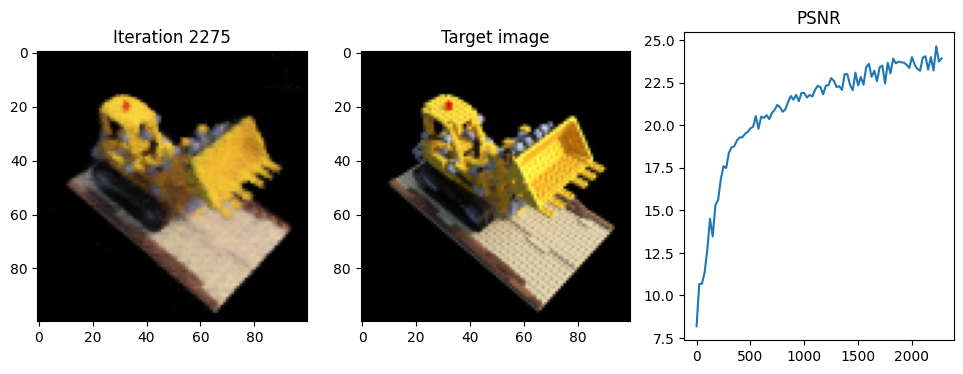

 77%|███████▋  | 2300/3001 [33:48<09:48,  1.19it/s]

Iteration 2300  Loss: 0.0038  PSNR: 24.25  Time: 0.88 secs per iter,  33.94 mins in total


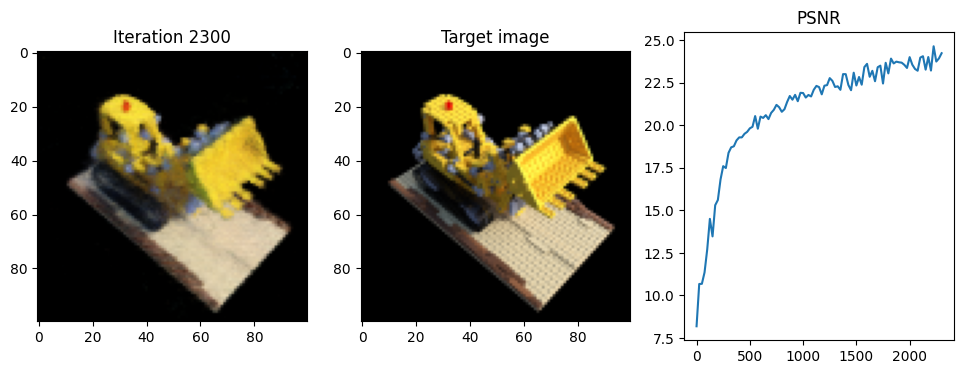

 77%|███████▋  | 2325/3001 [34:09<09:30,  1.19it/s]

Iteration 2325  Loss: 0.0041  PSNR: 23.83  Time: 0.87 secs per iter,  34.30 mins in total


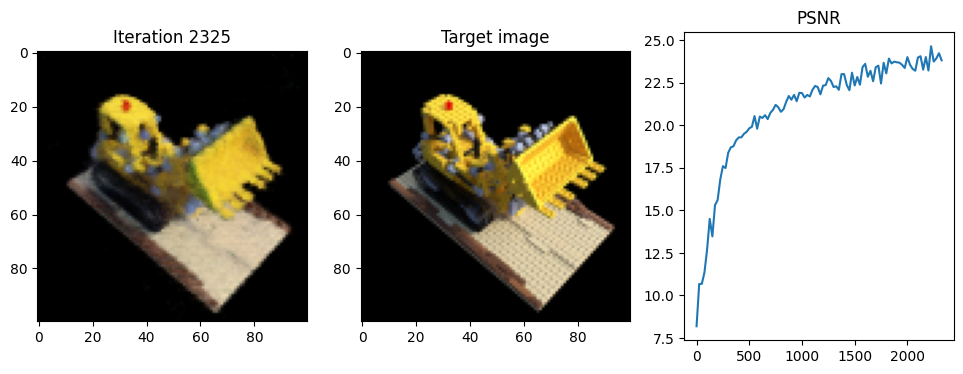

 78%|███████▊  | 2350/3001 [34:31<09:02,  1.20it/s]

Iteration 2350  Loss: 0.0037  PSNR: 24.37  Time: 0.87 secs per iter,  34.67 mins in total


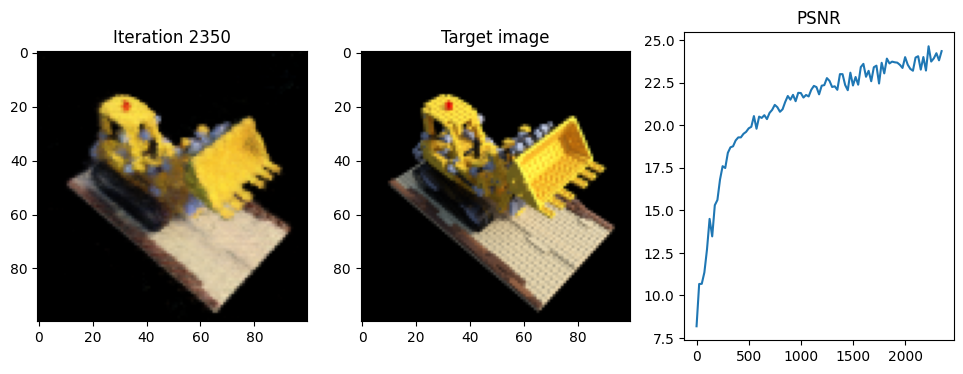

 79%|███████▉  | 2375/3001 [34:53<08:41,  1.20it/s]

Iteration 2375  Loss: 0.0044  PSNR: 23.58  Time: 0.88 secs per iter,  35.03 mins in total


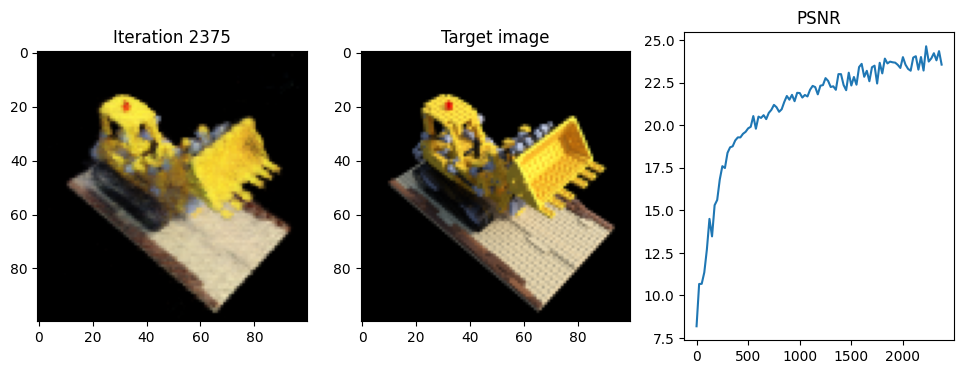

 80%|███████▉  | 2400/3001 [35:15<08:21,  1.20it/s]

Iteration 2400  Loss: 0.0035  PSNR: 24.56  Time: 0.87 secs per iter,  35.40 mins in total


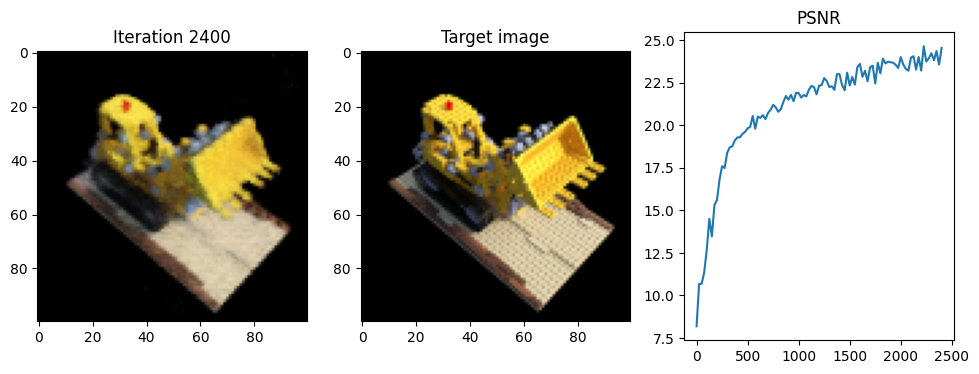

 81%|████████  | 2425/3001 [35:37<08:00,  1.20it/s]

Iteration 2425  Loss: 0.0040  PSNR: 23.98  Time: 0.87 secs per iter,  35.76 mins in total


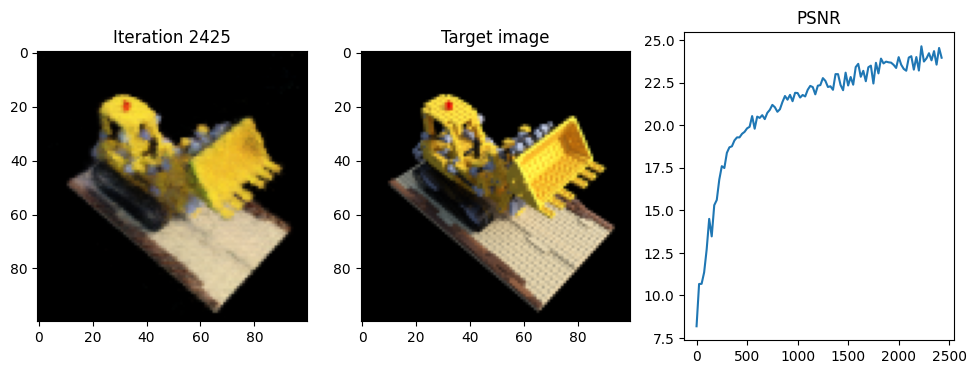

 82%|████████▏ | 2450/3001 [35:58<07:36,  1.21it/s]

Iteration 2450  Loss: 0.0035  PSNR: 24.59  Time: 0.86 secs per iter,  36.12 mins in total


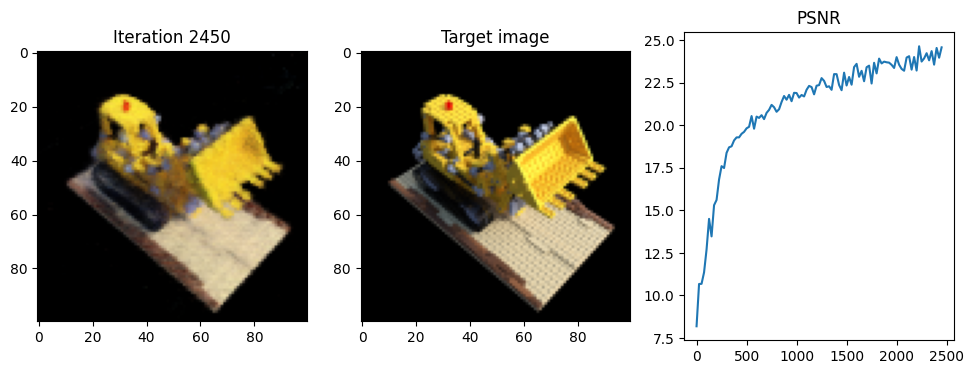

 82%|████████▏ | 2475/3001 [36:20<07:16,  1.21it/s]

Iteration 2475  Loss: 0.0035  PSNR: 24.54  Time: 0.87 secs per iter,  36.48 mins in total


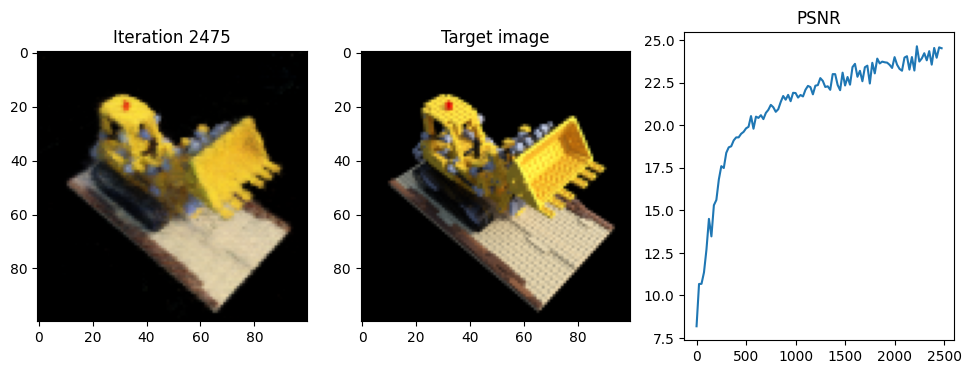

 83%|████████▎ | 2500/3001 [36:42<06:58,  1.20it/s]

Iteration 2500  Loss: 0.0040  PSNR: 24.02  Time: 0.87 secs per iter,  36.84 mins in total


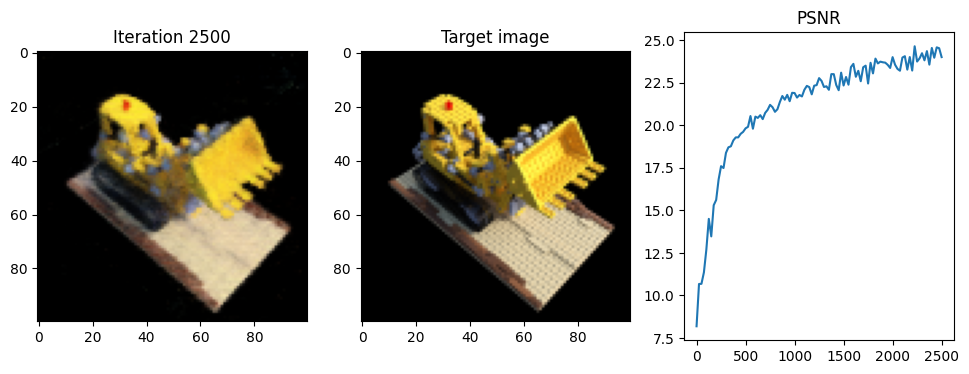

 84%|████████▍ | 2525/3001 [37:03<06:29,  1.22it/s]

Iteration 2525  Loss: 0.0039  PSNR: 24.05  Time: 0.86 secs per iter,  37.20 mins in total


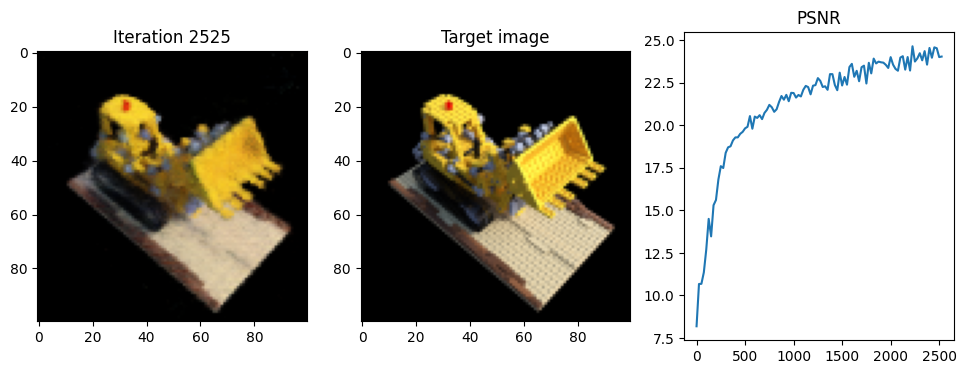

 85%|████████▍ | 2550/3001 [37:25<06:13,  1.21it/s]

Iteration 2550  Loss: 0.0038  PSNR: 24.19  Time: 0.87 secs per iter,  37.56 mins in total


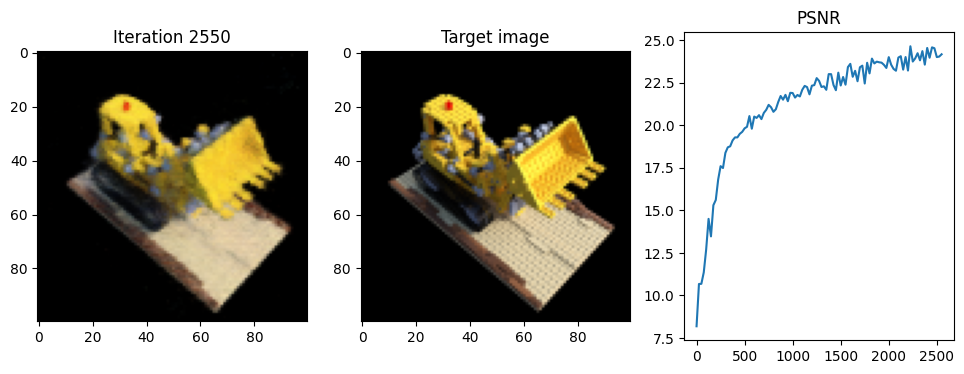

 86%|████████▌ | 2575/3001 [37:47<05:48,  1.22it/s]

Iteration 2575  Loss: 0.0042  PSNR: 23.72  Time: 0.86 secs per iter,  37.92 mins in total


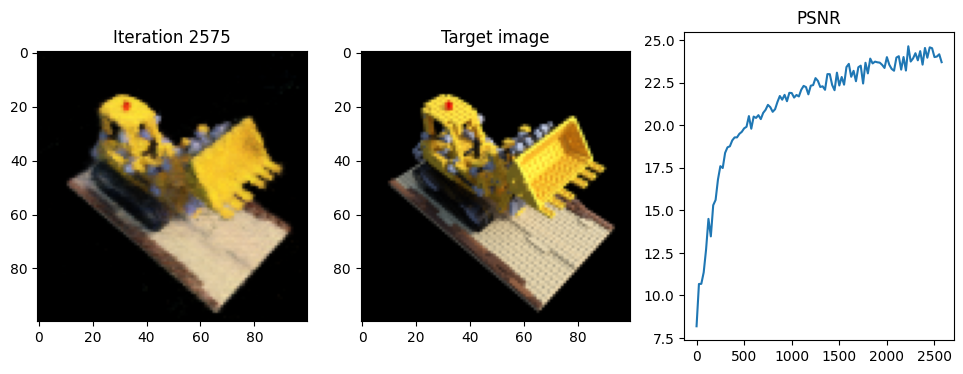

 87%|████████▋ | 2600/3001 [38:08<05:29,  1.22it/s]

Iteration 2600  Loss: 0.0037  PSNR: 24.33  Time: 0.87 secs per iter,  38.28 mins in total


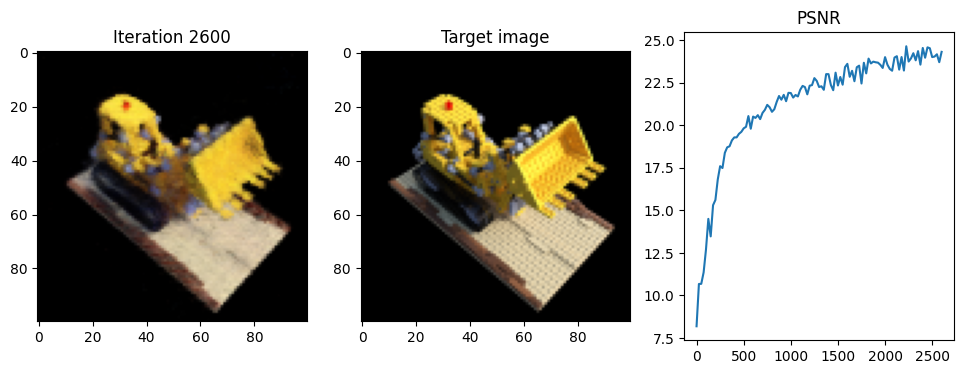

 87%|████████▋ | 2625/3001 [38:30<05:12,  1.20it/s]

Iteration 2625  Loss: 0.0041  PSNR: 23.86  Time: 0.87 secs per iter,  38.65 mins in total


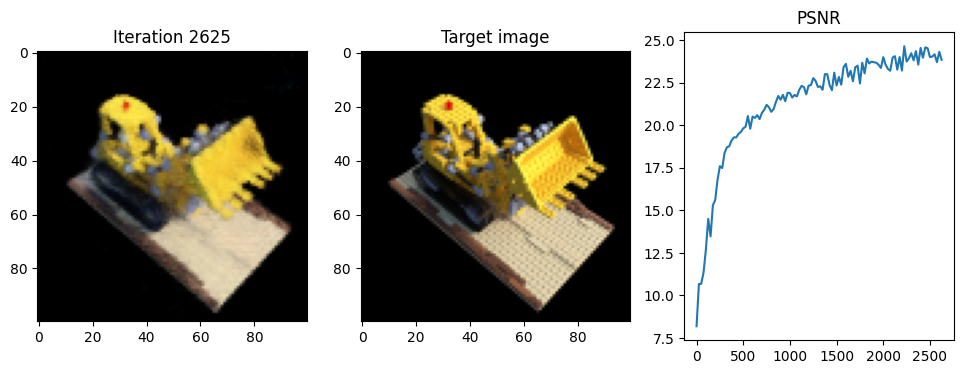

 88%|████████▊ | 2650/3001 [38:52<04:54,  1.19it/s]

Iteration 2650  Loss: 0.0036  PSNR: 24.47  Time: 0.89 secs per iter,  39.02 mins in total


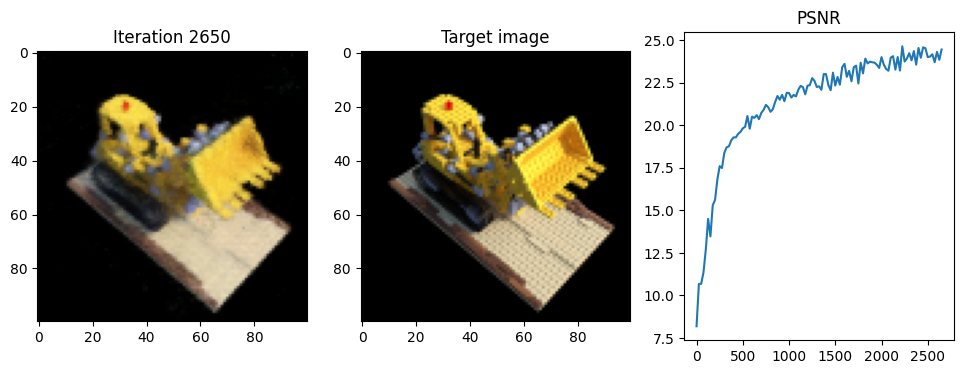

 89%|████████▉ | 2675/3001 [39:14<04:35,  1.18it/s]

Iteration 2675  Loss: 0.0043  PSNR: 23.71  Time: 0.88 secs per iter,  39.38 mins in total


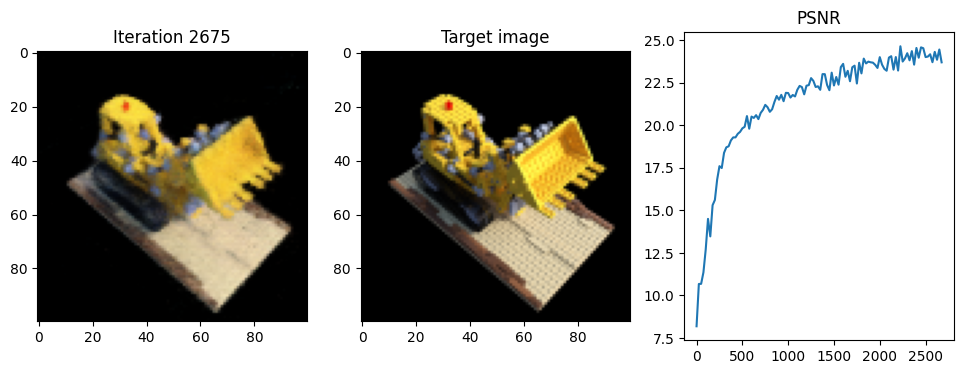

 90%|████████▉ | 2700/3001 [39:36<04:12,  1.19it/s]

Iteration 2700  Loss: 0.0033  PSNR: 24.81  Time: 0.88 secs per iter,  39.75 mins in total


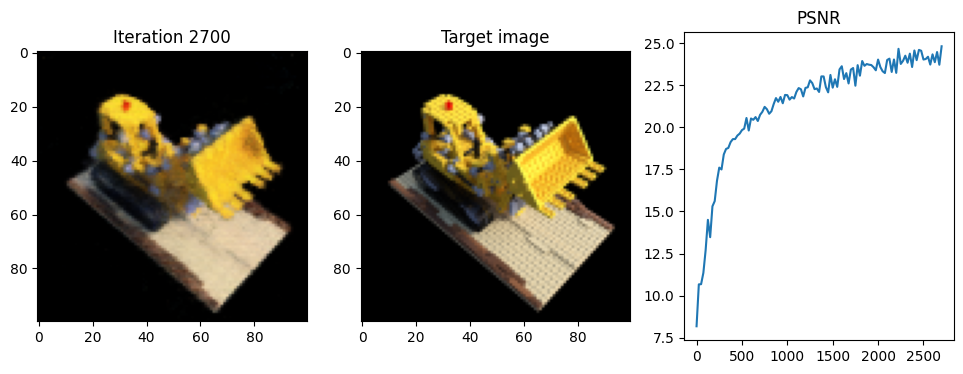

 91%|█████████ | 2725/3001 [39:58<03:50,  1.20it/s]

Iteration 2725  Loss: 0.0032  PSNR: 24.91  Time: 0.88 secs per iter,  40.12 mins in total


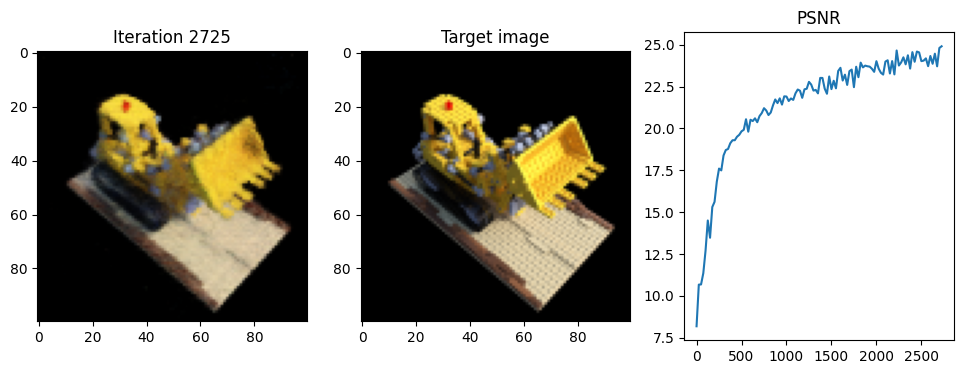

 92%|█████████▏| 2750/3001 [40:20<03:29,  1.20it/s]

Iteration 2750  Loss: 0.0035  PSNR: 24.54  Time: 0.88 secs per iter,  40.48 mins in total


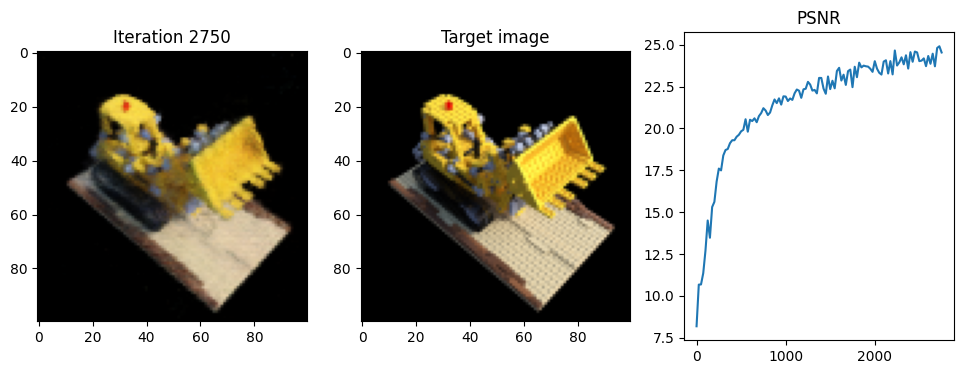

 92%|█████████▏| 2775/3001 [40:42<03:12,  1.17it/s]

Iteration 2775  Loss: 0.0038  PSNR: 24.26  Time: 0.88 secs per iter,  40.85 mins in total


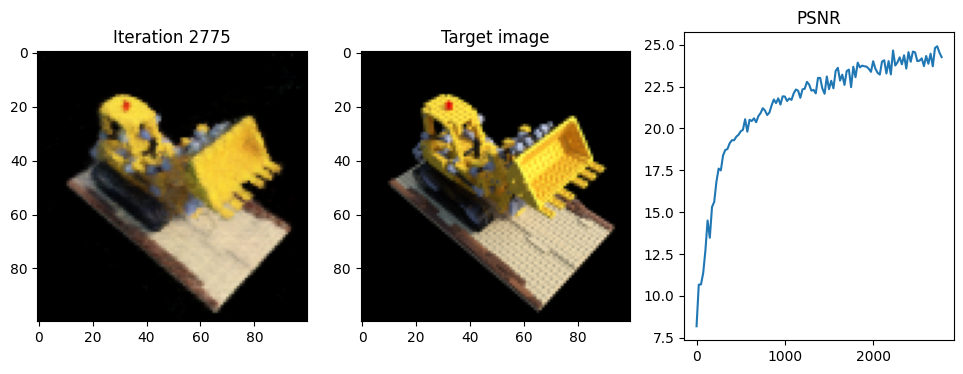

 93%|█████████▎| 2800/3001 [41:04<02:47,  1.20it/s]

Iteration 2800  Loss: 0.0031  PSNR: 25.11  Time: 0.87 secs per iter,  41.21 mins in total


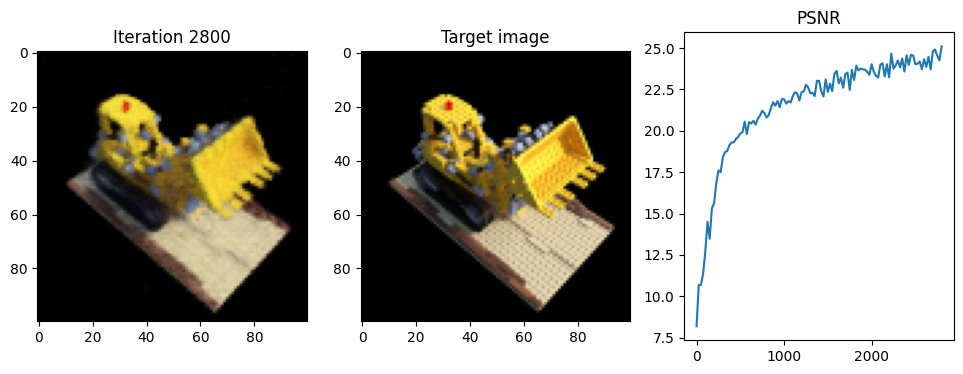

 94%|█████████▍| 2825/3001 [41:26<02:27,  1.19it/s]

Iteration 2825  Loss: 0.0030  PSNR: 25.18  Time: 0.88 secs per iter,  41.58 mins in total


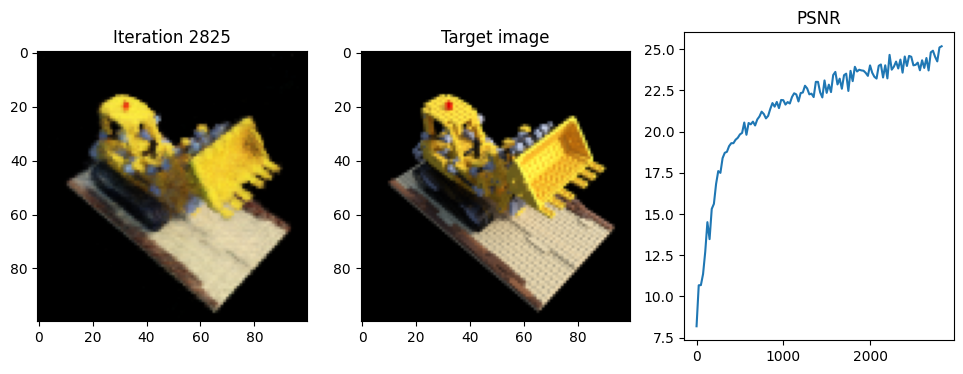

 95%|█████████▍| 2850/3001 [41:48<02:07,  1.19it/s]

Iteration 2850  Loss: 0.0037  PSNR: 24.34  Time: 0.88 secs per iter,  41.95 mins in total


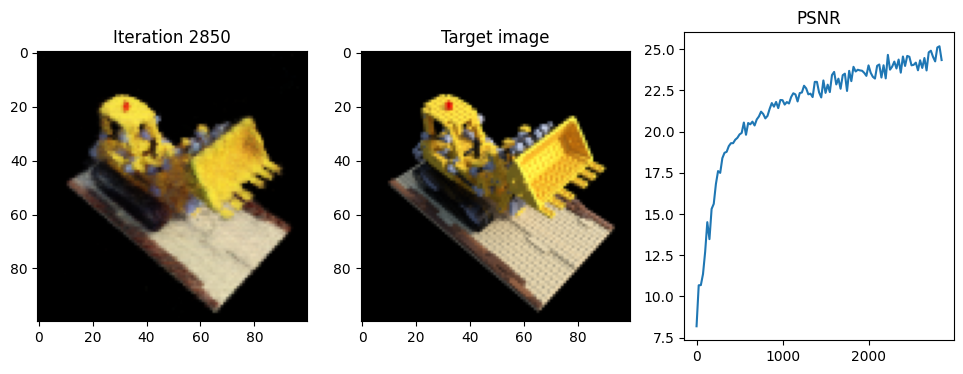

 96%|█████████▌| 2875/3001 [42:10<01:48,  1.16it/s]

Iteration 2875  Loss: 0.0034  PSNR: 24.65  Time: 0.89 secs per iter,  42.32 mins in total


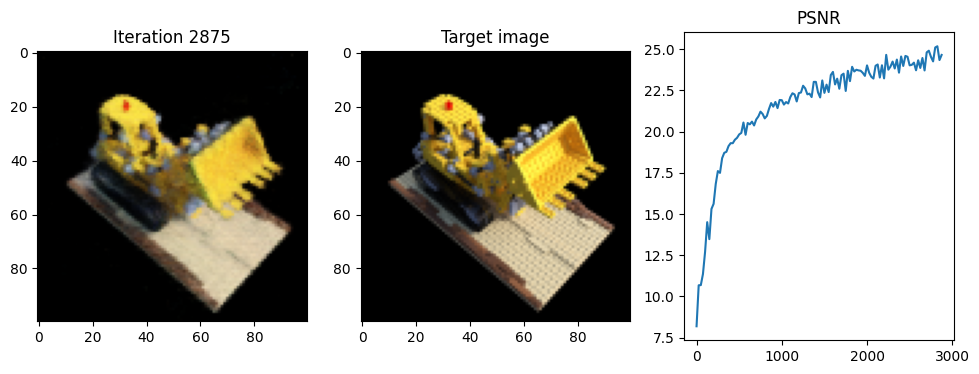

 97%|█████████▋| 2900/3001 [42:32<01:24,  1.19it/s]

Iteration 2900  Loss: 0.0033  PSNR: 24.86  Time: 0.88 secs per iter,  42.68 mins in total


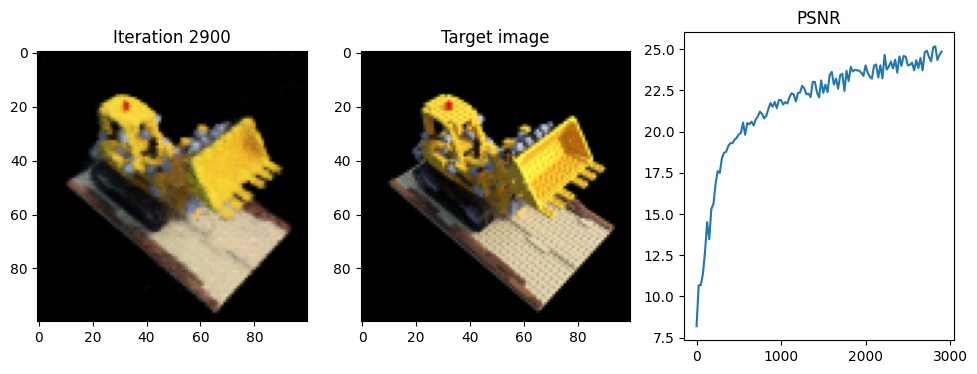

 97%|█████████▋| 2925/3001 [42:54<01:03,  1.19it/s]

Iteration 2925  Loss: 0.0033  PSNR: 24.78  Time: 0.88 secs per iter,  43.05 mins in total


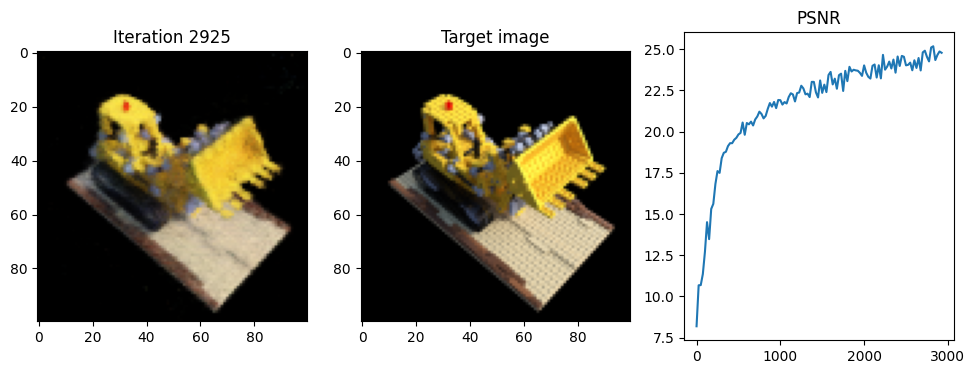

 98%|█████████▊| 2950/3001 [43:16<00:42,  1.19it/s]

Iteration 2950  Loss: 0.0040  PSNR: 23.94  Time: 0.88 secs per iter,  43.42 mins in total


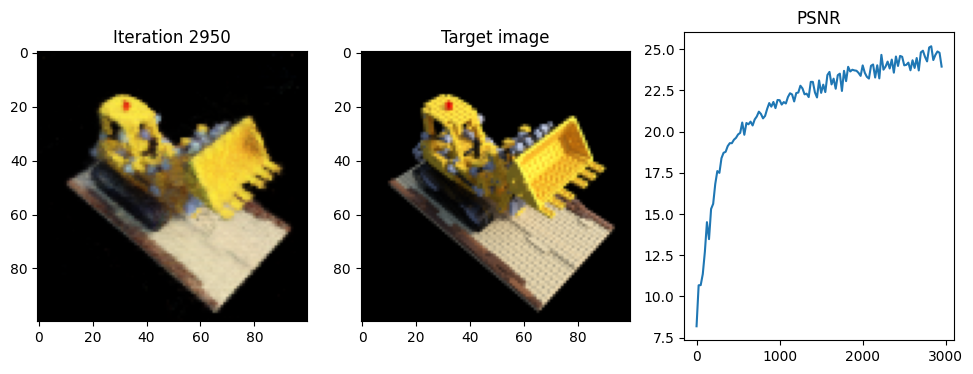

 99%|█████████▉| 2975/3001 [43:38<00:21,  1.19it/s]

Iteration 2975  Loss: 0.0034  PSNR: 24.72  Time: 0.88 secs per iter,  43.78 mins in total


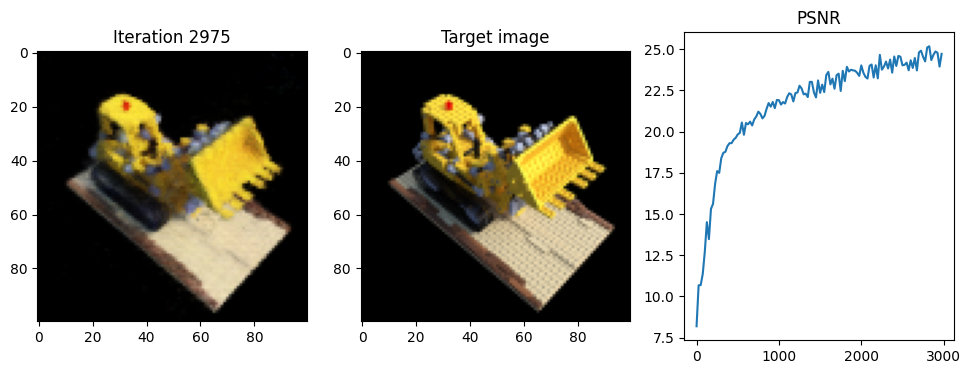

100%|█████████▉| 3000/3001 [44:00<00:00,  1.19it/s]

Iteration 3000  Loss: 0.0039  PSNR: 24.12  Time: 0.88 secs per iter,  44.15 mins in total


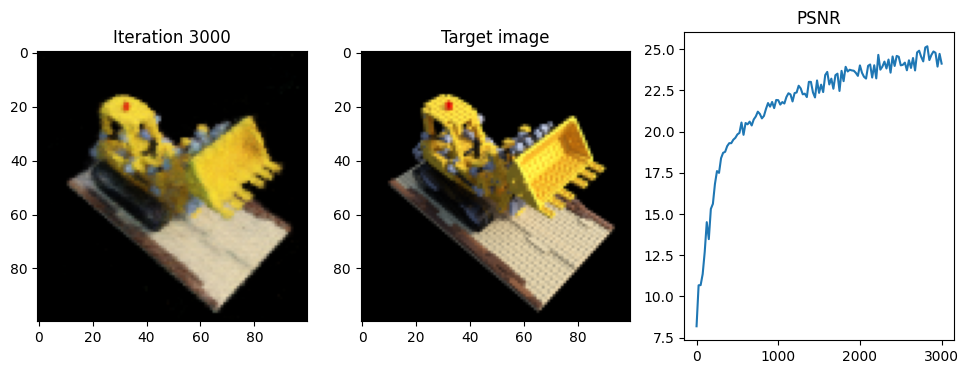

100%|██████████| 3001/3001 [44:02<00:00,  1.14it/s]

Done!


In [77]:
from matplotlib import image
import tqdm

# for i in range(iterations+1):
for i in tqdm.tqdm(range(iterations+1)):

    #choose randomly a picture for the forward pass
    if device == 'cuda':
      torch.cuda.empty_cache()

    pic_idx = np.random.randint(images.shape[0])
    random_image, random_pose = images[pic_idx], poses[pic_idx]

    # Run one iteration of NeRF and get the rendered RGB image.
    optimizer.zero_grad()

    height, width = random_image.shape[0], random_image.shape[1]

    rec_img = one_forward_pass(height, width, intrinsics, random_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)

    # Compute mean-squared error between the predicted and target images. Backprop!
    loss = criterion(rec_img, random_image)

    loss.backward()

    optimizer.step()


    # Display images/plots/stats
    if i % display == 0:
        with torch.no_grad():
            # Render the held-out view
            test_rec_image = one_forward_pass(height, width, intrinsics, test_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)
            loss = nn.MSELoss()(test_rec_image, test_image)

        #calculate the loss and the psnr between the original test image and the reconstructed one.
        psnr = 10*torch.log10(1/loss)

        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))

        t = time.time()
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

print('Done!')

In [78]:
torch.save(model.state_dict(), 'nerf_3000_iter.pth')


In [14]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2


model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)
model.load_state_dict(torch.load('nerf_3000_iter.pth', map_location=torch.device(device)))
model.eval()

nerf_model(
  (linear1): Linear(in_features=63, out_features=256, bias=True)
  (linear2): Linear(in_features=256, out_features=256, bias=True)
  (linear3): Linear(in_features=256, out_features=256, bias=True)
  (linear4): Linear(in_features=256, out_features=256, bias=True)
  (linear5): Linear(in_features=256, out_features=256, bias=True)
  (linear6): Linear(in_features=319, out_features=256, bias=True)
  (linear7): Linear(in_features=256, out_features=256, bias=True)
  (linear8): Linear(in_features=256, out_features=256, bias=True)
  (linearsigma): Linear(in_features=256, out_features=1, bias=True)
  (linear9): Linear(in_features=256, out_features=256, bias=True)
  (linear10): Linear(in_features=283, out_features=128, bias=True)
  (linear11): Linear(in_features=128, out_features=3, bias=True)
  (relu1): ReLU()
  (relu2): ReLU()
  (relu3): ReLU()
  (relu4): ReLU()
  (relu5): ReLU()
  (relu6): ReLU()
  (relu7): ReLU()
  (relu8): ReLU()
  (relu9): ReLU()
  (sigmoid): Sigmoid()
)

tensor([[ 1.3036e-01, -5.9733e-01,  7.9133e-01, -1.0633e+00],
        [-9.9147e-01, -7.8537e-02,  1.0404e-01, -1.3980e-01],
        [ 7.4506e-09, -7.9814e-01, -6.0247e-01,  8.0955e-01],
        [ 0.0000e+00, -0.0000e+00, -0.0000e+00,  1.0000e+00]], device='cuda:0')
alpha shape :  torch.Size([100, 100, 64])
After adding ones, alpha shape :  torch.Size([100, 100, 65])
Weights shape :  torch.Size([100, 100, 64])
Depth map shape :  torch.Size([100, 100])


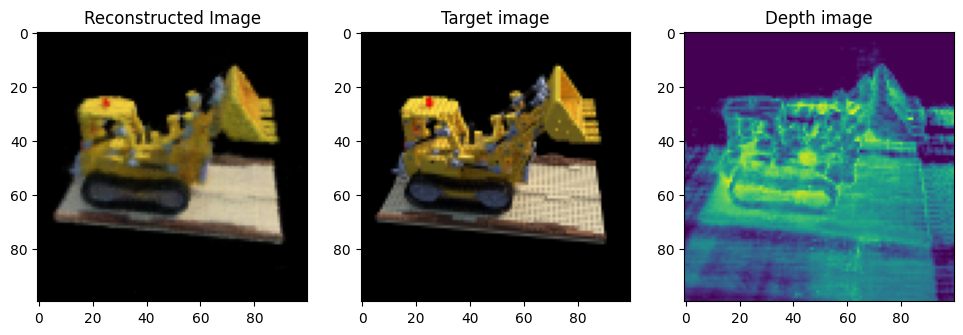

In [45]:
# Display images/plots/stats
index = np.random.randint(images.shape[0])

trial_image, trial_pose = images[index], poses[index]
print(trial_pose)
rec_image, depth_img = one_forward_pass(height, width, intrinsics, trial_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)

plt.figure(figsize=(16, 4))
plt.subplot(141)
plt.imshow(rec_image.detach().cpu().numpy())
plt.title("Reconstructed Image")
plt.subplot(142)
plt.imshow(trial_image.detach().cpu().numpy())
plt.title("Target image")
plt.subplot(143)
plt.imshow(depth_img.detach().cpu().numpy())
plt.title("Depth image")
plt.show()